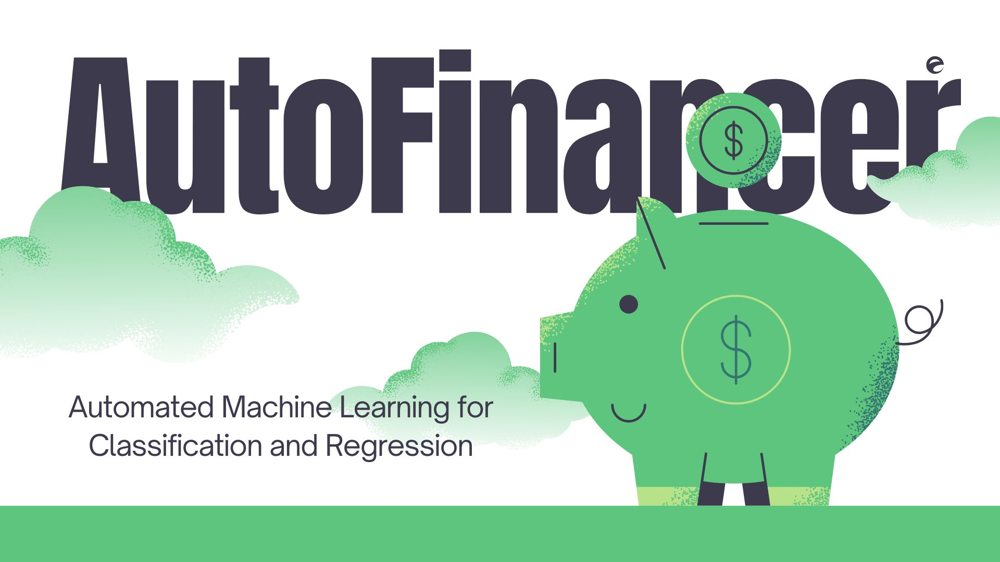

## Introduction

This tutorial demonstrates how to use the `AutoFinancer` package for automated machine learning (AutoML).
The package is designed to handle binary classification, multi-class classification and regression tasks.
It offers an end-to-end solution for data preprocessing, model selection, hyperparameter optimization and result evaluation.

This package is intended for:
- **Bank employees**
- **Financial analysts**
- **Employees of financial institutions**
- **Risk management specialists**
- **Data scientists and machine learning engineers** working in the financial sector.

The AutoML package supports three main types of machine learning problems:
1. **Binary Classification**
2. **Multiclass Classification**
3. **Regression**

This specialization makes it suitable for a wide range of practical applications.

### Comparison with similar packages:

Popular tools such as **AutoGluon** and **mljar** provide similar functionalities. However, the `AutoFinancer` package offers several key differentiators:

1. **Customization and Flexibility**:
    - While **AutoGluon** and **mljar** offer high automation levels, `AutoFinancer` provides greater customization options for preprocessing, feature selection, and model optimization.
    - Users can control specific feature selection methods (`random_forest`, `select_k_best`, or both) and choose between `random_search` and `grid_search` for hyperparameter optimization.

2. **Integrated Report Generation**:
    - `AutoFinancer` includes a comprehensive reporting system that generates detailed reports with metrics, confusion matrices, ROC curves, feature importance plots, and model interpretability (e.g., Break Down and Ceteris Paribus plots for regression tasks).
    - In contrast, **AutoGluon** and **mljar** focus more on prediction performance without native support for detailed interpretability reports.

3. **Target Audience and Usability**:
    - While **AutoGluon** is geared toward general-purpose machine learning tasks, `AutoFinancer` specifically caters to financial and banking applications.
    - **mljar**, with its automatic web-based interface, is user-friendly for non-developers but lacks the in-depth control over the training pipeline provided by `AutoFinancer`.

4. **Performance Tuning**:
    - `AutoFinancer` allows for fine-tuning parameters such as cross-validation folds, number of iterations, and correlation thresholds, which gives advanced users the flexibility to balance performance and computational efficiency.
    - **AutoGluon** focuses on stacking and ensembling models for maximum accuracy, which can sometimes result in longer training times.

5. **Problem Type Specialization**:
    - The `AutoFinancer` package supports binary classification, multi-class classification and regression tasks with tailored approaches for each type, ensuring robust handling of a wide range of datasets.

## Parameters

**problem_type** : `str`, default=`'binary_classification'`  
    Type of machine learning task to be performed.  
    Accepted values:  
    - `'binary_classification'`: Two-class classification task.  
    - `'multiclass_classification'`: Multi-class classification task.  
    - `'regression'`: Regression task for continuous target values.


**metric** : `str`, default=None, if none, `'accuracy'` is chosen for classification and `'r2'` for regression  
    Evaluation metric to be used during model selection.  
    Accepted values for classification:  
    - `'roc_auc'`, `'accuracy'`, `'precision'`, `'recall'`, `'f1'`, `'balanced_accuracy'`  
    Accepted values for regression:  
    - `'r2'`, `'neg_mean_squared_error'`, `'neg_mean_absolute_error'`


**random_state** : `int`, default=`2024`  
    Random seed used for reproducibility of results.  
    Accepted values: Any integer.


**k** : `int`, default=`10`  
    Number of features to select using the `SelectKBest` method.  
    Accepted values: Positive integer.


**correlation_threshold** : `float`, default=`0.9`  
    Threshold for removing highly correlated features.  
    Features with correlation higher than this value are excluded.  
    Accepted values: A float in the range `[0.0, 1.0]`.


**selection_method** : `str`, default=`'both'`  
    Method to use for feature selection.  
    Accepted values:  
    - `'random_forest'`: Feature selection based on Random Forest importance.  
    - `'select_k_best'`: Statistical feature selection using `SelectKBest`.  
    - `'both'`: Combines both methods.


**method** : `str`, default=`'random_search'`  
    Hyperparameter optimization strategy.  
    Accepted values:  
    - `'random_search'`: Randomized search over hyperparameter space.  
    - `'grid_search'`: Exhaustive search over specified parameter grid.


**cv_folds** : `int`, default=`5`  
    Number of cross-validation folds.  
    Accepted values: Integer greater than 1.


**n_iter** : `int`, default=`10`  
    Number of iterations for randomized search.  
    Accepted values: Positive integer.

## Components

The package is an automated machine learning system with the following main components:

### 1. Automated Model Training and Optimization (`train` method)
- **Purpose**: Automates the training process, including data preprocessing, model selection, and optimization.
- **Parameters**:
 - `X` (array/DataFrame): Input data;
 - `y` (array/Series): Target variable.
- **Key Steps**:
  1. **Data Preprocessing**: Prepares the input data (`X`) and target variable (`y`) for model training. This includes handling missing values, feature scaling, and encoding categorical variables.
  2. **Model Selection and Optimization**: Selects the best model from a pool of candidates and tunes its hyperparameters, using methods like `RandomizedSearchCV` and `GridSearchCV` (optional).
  3. **Report Generation**: Produces detailed performance reports summarizing the training and optimization process.
- **Attributes**:
 - `summary`: table of basic descriptive statistics for numerical variables,
 - `unique_values`: list of labels in target variable,
 - `class_counts`: only for `problem_type = 'binary_classification'` and `problem_type = 'multiclass_classification'`, list of labels in target variable,
 - `final_features`: list of features selected during feature selection process,
 - `results`: list of results received during training process concluding name of model, chosen parameters, evaluation score, metric used for evaluation, time of fitting,
 - `scores[model_name]`: table of scores achieved during training process for a chosen metric,
 - `optimizers[model_name]`: visualization of a chosen model with its parameters,
 - `all_results`: table of all best models, their chosen parameters, scores, evaluation metrics and training time.

---

### 2. Prediction (`predict` method)
- **Purpose**: Provides predictions for new data using the selected or optimized models.
- **Parameters**:
 - `X` (DataFrame): Input data;
 - `model_name` (str): Name of model, if None, best model on training data is used.
- **Returns**:
 - `y_pred` (Series): Vector of predicted classes.
- **Key Features**:
  - Accepts an optional `model_name` parameter to specify which model to use. If none is provided, the best model from training is used.
  - Preprocesses test data to ensure compatibility with the trained model.
  - Outputs predictions as a series.

---

### 3. Probability Prediction (`predict_proba` method)
- **Purpose**: Computes and returns class probabilities for classification problems.
- **Parameters**:
 - `X` (array/DataFrame): Input data;
 - `model_name` (str): Name of model, if None, best model on training data is used.
- **Returns**:
 - `y_pred` (Series): Vector of predicted probabilities.
- **Key Features**:
  - Applicable only to classification tasks (`binary_classification` or `multiclass_classification`).
  - Preprocesses input data and allows specifying a model via the `model_name` parameter. If none is provided, the best model from training is used.
  - Outputs probabilities for each class as a series.

---

### 4. Prediction and Report Generation (`predict_and_report` method)
- **Purpose**: Combines prediction, probability prediction (for classification), and report generation for a test dataset.
- **Parameters**:
 - `X` (array/DataFrame): Test data;
 - `y` (array/Series): Target for test data;
 - `model_name` (str): Name of model, if None, best model on training data is used;
 - `prediction_threshold` (float): Threshold used for confusion matrices (only for binary classification).
- **Key Features**:
  1. Preprocesses both test input data (`X`) and target labels (`y`).
  2. Computes predictions and probabilities (if applicable).
  3. Generates detailed reports:
     - **Binary Classification**: Includes performance metrics such as accuracy, precision, recall, f1, balanced accuracy, AUC, visualization of ROC curve and confusion matrix with an optional `prediction_threshold`.
     - **Multiclass Classification**: Summarizes class-level performance metrics such as accuracy, precision, recall, f1, balanced accuracy, AUC, visualization of ROC curve and confusion matrix.
     - **Regression**: Reports regression metrics such as R², MSE, MAE.

### Preprocessing

The package includes comprehensive preprocessing functions to handle missing data, normalize features, and encode categorical variables.
This section describes the key methods responsible for preparing the data before model training.

#### Key Methods:
1. **Converting target variable `y`** to Series type.

2. **Converting input data `X`** to DataFrame type.

3. **Handling missing values in `y`**: rows with missing values in `y` are removed before proceeding with further preprocessing

4. **Processing target variable (`y`)** based on the problem type:
   - For **binary classification**, it maps the target to 0 and 1.
   - For **multiclass classification**, it uses `LabelEncoder` to encode the target into numerical labels.
   - For **regression**, it ensures that the target variable is converted to a numeric type.

5. Identifying **binary**, **numerical**, **categorical**, and **datetime** columns.

6. **Handling missing data** is a critical part of preprocessing, especially when dealing with real-world datasets.
The package uses different strategies depending on the type of the variable:

  - **Symmetric numerical columns**: Missing values are imputed using the mean.
  - **Skewed numerical columns**: Missing values are imputed using the median.
  - **Categorical columns**: Missing values are imputed using the most frequent category (mode).
  - **Binary columns**: Missing values are imputed using iterative imputation with a `RandomForestRegressor` to maintain correlations with other variables.

7. **Standardizing numerical features**: Numerical features are standardized using `StandardScaler`, which ensures that the mean is 0 and the variance is 1.

8. **Encoding categorical variables** using `LabelEncoder`. This ensures that the model can interpret these variables correctly by converting them into numerical values.

9. **Feature selection**: Feature selection is a critical step in machine learning workflows. It helps improve model performance by reducing overfitting, speeding up training, and improving model interpretability. The `AutoFinancer` package incorporates multiple feature selection techniques to identify the most relevant features. After feature selection, the package stores the selected features in the `self.final_features` attribute, and these features are used in subsequent model training and evaluation steps.

 - **Correlation-based Feature Removal**:
   Highly correlated features can introduce multicollinearity, negatively impacting the model’s performance. The package identifies pairs of highly correlated features and removes one of them if their correlation exceeds a specified threshold (default: 0.9).

 - **Random Forest-based Feature Selection**:
   This method uses the feature importances provided by a `RandomForestClassifier` to rank and select the top-k features. Random Forest is effective at capturing complex feature interactions.

 - **Statistical Feature Selection with SelectKBest**:
   This method uses statistical tests, specifically ANOVA F-tests (`f_classif`), to rank and select the top-k features based on their relationship with the target variable. It’s particularly useful for identifying features that have a significant linear correlation with the target.

 - **Combined Method**:
   The combined method merges the results from both the Random Forest-based and statistical selection methods. Only the features selected by both approaches are retained for the final model training, ensuring robust feature selection.

### Model Selection and Optimization

The `AutoFinancer` package supports automatic model selection and hyperparameter tuning using two primary methods:
- **Random search**
- **Grid search** (optional)

These methods allow efficient exploration of hyperparameter spaces, leading to better model performance.

#### **Random Search vs. Grid Search**

**Random Search**:  
- Randomly samples hyperparameters from specified distributions.  
- **Default Parameter**: `n_iter=10` (number of iterations).  
- Suitable for large hyperparameter spaces or when computational resources are limited.

**Grid Search**:  
- Exhaustively searches through a manually specified subset of hyperparameters.  
- A predefined grid of values for each model.  
- Best used for smaller hyperparameter spaces or when computational time is not a constraint.


#### **Cross-Validation Strategy**

The package uses **k-fold cross-validation** for model evaluation during hyperparameter optimization.
- **Default Parameter**: `cv_folds=5` (number of folds in cross-validation).  
This approach ensures that the model is tested on different subsets of data, providing a robust estimate of its performance.


#### **Models and Their Hyperparameters**

The following models are supported by the package, along with their hyperparameters that are tuned during optimization process:

| Model                  | Tuned Hyperparameters                                         |
|------------------------|-----------------------------------------------------------------|
| **RandomForest**       | `n_estimators`, `max_depth`, `min_samples_split`     |
| **DecisionTree**       | `max_depth`, `min_samples_split`                         |
| **XGBoost**            | `n_estimators`, `max_depth`, `learning_rate`          |
| **GradientBoosting**   | `n_estimators`, `max_depth`, `learning_rate`          |
| **LogisticRegression** | `penalty=None`, `solver='saga'`, `max_iter=500`                |
| **LassoRegression** | `penalty=l1`, `solver='saga'`, `max_iter=500`, `C`                |
| **RidgeRegression** | `penalty=l1`, `solver='saga'`, `max_iter=500`, `C`                |
| **LDA** | `store_covariance=True`, `solver`                |
| **QDA** | `store_covariance=True`, `reg_param`                |
| **LinearRegression**   | Standard linear regression without hyperparameters              |



#### **Evaluation Metrics**

The package automatically selects appropriate metrics based on the problem type:

**Classification Metrics**:
- **Default Metric**: `accuracy`  
- Other Supported Metrics:  
  - `roc_auc`  
  - `precision`  
  - `recall`  
  - `f1`  
  - `balanced_accuracy`

**Regression Metrics**:
- **Default Metric**: `r2`  
- Other Supported Metrics:  
  - `neg_mean_squared_error`  
  - `neg_mean_absolute_error`

These metrics ensure comprehensive evaluation of model performance for both classification and regression tasks.

### Postprocessing Functions and Report Generation

After model training, the package generates a comprehensive report that includes:

1. Summary with basic results for the best model.

2. A tabular summary showing the model names, best parameters, scores, evaluation metrics, and training times.

3. Overall descriptive statistics of the processed dataset for numerical variables.

4. Histogram for target variable `y` with its distribution (only for regression task).

5. Classes breakdown for target variable `y` (only for classification task).

6. **Permutation Importance** – Shows the relative importance of each feature by measuring the drop in model performance when the feature's values are permuted.

7. **Partial Dependence Profiles (PDP)** – Displays how a feature affects the predicted outcome, averaged over all instances.

8. **Accumulated Local Effects (ALE)** – Similar to PDP but accounts for feature interactions more robustly.

9. **Break Down plots** – Explains individual predictions by showing how each feature contributes to the final prediction (for observations with the largest and smallest prediction difference from actual values for the best model for regression task).

10. **Ceteris Paribus plots** – Displays how changing one feature affects the prediction while keeping other features constant (for observations with the largest and smallest prediction difference from actual values for the best model for regression task).

11. Reports based on specifics of each model:
 - **DecisionTree** - Scores for decision tree, Textual representation of the tree, Decision tree visualization, Feature importance plots.
 - **RandomForest and GradientBoosting** - Scores for random forest and gradient boosting, Visualization of the first decision tree, Feature importance plots.
 - **XGBoost** - Scores for XGBoost, Feature importance plots.
 - **LogisticRegression, LassoRegression, RidgeRegression** - Scores for logistic, lasso and ridge regression, Model coefficients Visualization of model coefficients.
 - **LDA** - Scores for linear discriminant analysis, Model coefficients, Visualization of model coefficients, Means and covariance matrix.
 - **QDA** - Scores for quadratic discriminant analysis, Means and covariance matrix.
 - **LinearRegression** - Scores for linear regression, Model coefficients, Visualization of model coefficients.

This approach ensures that users not only receive high-level insights into the model's performance but also have access to in-depth, model-specific analyses, making it easier to interpret and trust the results.

## Innovative Approach

This package incorporates several advanced libraries and methods to enhance its functionality:

- **dalex**: Provides advanced model interpretability, generating insights such as Break Down plots and Ceteris Paribus profiles.
- **Iterative Imputer**: Imputes missing binary values using a machine learning model (`RandomForestRegressor`) to maintain correlations between features.

### Adaptability to Problem Type
The package dynamically adapts its behavior based on the user-specified `problem_type`.
Supported types include:
- **Binary Classification**
- **Multiclass Classification**
- **Regression**

For each problem type, the package automatically:
- Selects suitable models (e.g., `RandomForestClassifier` for classification tasks or `LinearRegression` for regression).
- Applies appropriate scoring metrics (e.g., `accuracy` for classification or `R²` for regression).
- Customizes preprocessing methods (e.g., encoding categorical variables or converting targets based on the problem type).

### Customizable Hyperparameter Optimization
Users have full control over hyperparameter optimization by selecting:
- **Random Search**: Efficient for large parameter spaces with limited computational resources.
- **Grid Search**: Exhaustive for smaller parameter spaces to find the best hyperparameters.

Additionally, users can configure:
- **Number of cross-validation folds (`cv_folds`)**
- **Number of iterations in random search (`n_iter`)**

### Feature Selection Customization
Feature selection is an essential step in building effective models. This package offers:
- **Multiple Feature Selection Methods**:
  - `random_forest`: Selects important features using a Random Forest model.
  - `select_k_best`: Selects the top `k` features based on statistical tests.
  - `both`: Combines the results of both methods.
- **Adjustable Correlation Threshold**:
  - Highly correlated features (above a specified threshold) are automatically removed to reduce multicollinearity.
  - The default correlation threshold is **0.9**, but it can be customized by the user (`correlation_threshold` parameter).

### Advanced Reporting
The package includes comprehensive reporting capabilities, such as:
- **Summary Reports**: Display the performance of all trained models and highlight the best-performing model.
- **Individual Model Reports**:
  - Provide detailed insights into a specific model, including:
    - Model details: Name, best parameters, and performance score.
    - Visualizations:
      - Decision tree plots for tree-based models.
      - Feature coefficients for linear models.
      - Break Down plots and Ceteris Paribus plots for interpretability.
- **Reporting on test dataset**, including:
 - Metric values on a test set,
 - ROC Curve (for classification),
 - Confusion Matrix (for classification).

## Tutorial

The tutorial will guide you through:

1. Loading and exploring data.
2. Creating and configuring the `AutoFinancer` object.
3. Training models and generating a report.
4. Making predictions on new data.
5. Generating report on test dataset.

### Example of using the package for binary classification

In [2]:
!pip install -r requirements.txt

#### Step 1: Loading and Exploring Data

In [3]:
from sklearn.datasets import fetch_openml
import pandas as pd

# Loading sample dataset
credit = fetch_openml(data_id=31)
X = credit.data
y = credit.target

In [4]:
from sklearn.model_selection import train_test_split

# Splitting into train and test datasets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [5]:
# Displaying data sample and target distribution
print("Training Data Sample:")
print(X_train.head())
print("Training Target Distribution:")
print(y_train.value_counts())

print("Testing Data Sample:")
print(X_test.head())
print("Testing Target Distribution:")
print(y_test.value_counts())

Training Data Sample:
    checking_status  duration                  credit_history  \
541     no checking        24              delayed previously   
440     no checking        12                   existing paid   
482              <0        30                   existing paid   
422        0<=X<200        12  critical/other existing credit   
778     no checking        36  critical/other existing credit   

                 purpose  credit_amount savings_status employment  \
541              new car           2032           <100        >=7   
440              new car           1884           <100        >=7   
482  furniture/equipment           3622         >=1000        >=7   
422              new car            958           <100     4<=X<7   
778             used car           5711         >=1000        >=7   

     installment_commitment     personal_status other_parties  \
541                       4         male single          none   
440                       4         male s

#### Step 2: Creating and Configuring AutoFinancer Object

In [2]:
from autofinancer import AutoFinancer

# Creating AutoFinancer object for binary classification
pipeline = AutoFinancer(problem_type='binary_classification',
                        metric = 'roc_auc',
                        k = 12,
                        correlation_threshold = 0.85,
                        selection_method = 'select_k_best',
                        method = 'grid_search',
                        cv_folds = 3
                        )

#### Step 3: Training Models

Training model: RandomForest
Preparation of a new explainer is initiated

  -> data              : 700 rows 12 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.GridSearchCV (default)
  -> label             : RandomForest
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.0916, mean = 0.699, max = 0.995
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.716, mean = 0.00292, max = 0.505
  -> model_info        : package sklearn

A new explainer has been created!
Training model: DecisionTree
Preparation of a new explainer is initiated

  -> data              : 700 rows 12 cols
  -> target variabl

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Preparation of a new explainer is initiated

  -> data              : 700 rows 12 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.GridSearchCV (default)
  -> label             : LogisticRegression
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.134, mean = 0.701, max = 0.979
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.948, mean = 3.48e-07, max = 0.821
  -> model_info        : package sklearn

A new explainer has been created!
Training model: LassoRegression


C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Preparation of a new explainer is initiated

  -> data              : 700 rows 12 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.GridSearchCV (default)
  -> label             : LassoRegression
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.206, mean = 0.701, max = 0.938
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.923, mean = 2.81e-05, max = 0.739
  -> model_info        : package sklearn

A new explainer has been created!
Training model: RidgeRegression


C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Preparation of a new explainer is initiated

  -> data              : 700 rows 12 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.GridSearchCV (default)
  -> label             : RidgeRegression
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.146, mean = 0.701, max = 0.962
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.944, mean = -2.36e-05, max = 0.805
  -> model_info        : package sklearn

A new explainer has been created!
Training model: LDA
Preparation of a new explainer is initiated

  -> data              : 700 rows 12 cols
  -> target variable   : Parameter 'y' was a pandas.S

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\discriminant_analysis.py:947: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")
C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\discriminant_analysis.py:972: RuntimeWarning: divide by zero encountered in power
  X2 = np.dot(Xm, R * (S ** (-0.5)))
C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\discriminant_analysis.py:972: RuntimeWarning: invalid value encountered in multiply
  X2 = np.dot(Xm, R * (S ** (-0.5)))
C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\discriminant_analysis.py:975: RuntimeWarning: divide by zero encountered in log
  u = np.asarray([np.sum(np.log(s)) for s in self.scalings_])
C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\discriminant_analysis.py:972: RuntimeWarning: divide by zero encountered in power
  X2 = np.dot(Xm, R * (S ** (-0.5)))
C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\discriminant_analysis.py:972: RuntimeWarning: invalid value encountered in multiply
  X2 = np.d

Preparation of a new explainer is initiated

  -> data              : 700 rows 12 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.GridSearchCV (default)
  -> label             : QDA
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 5.33e-06, mean = 0.659, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = 0.0419, max = 1.0
  -> model_info        : package sklearn

A new explainer has been created!

Report with model results:
----------------------------------
Best model: RandomForest
Best parameters: {'max_depth': 10, 'min_samples_split': 5, 'n_estimators': 100}
Best score

None
----------------------------------
Partial dependence profiles (PDP):


Calculating ceteris paribus: 100%|██████████| 12/12 [00:00<00:00, 27.12it/s]


None
----------------------------------
Accumulated local dependence profiles (ALE):


Calculating accumulated dependency: 100%|██████████| 12/12 [00:01<00:00,  6.73it/s]


None
----------------------------------

Raport with scores for model RandomForest:
----------------------------------
Model: RandomForest
Parameters: {'max_depth': 10, 'min_samples_split': 5, 'n_estimators': 100}
Score: 0.7727
Evaluation Metric: roc_auc
Training Time: 25.66 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.772710
1           accuracy  0.751421
2          precision  0.775703
3             recall  0.908350
4                 f1  0.836775
5  balanced_accuracy  0.645548
----------------------------------
Visualization of the first decision tree:


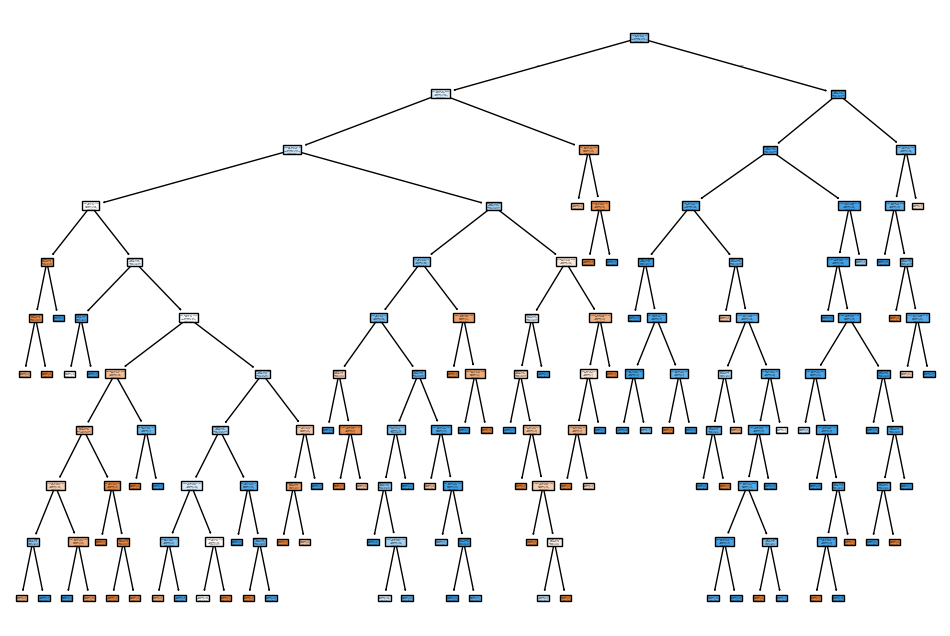

----------------------------------
Feature Importance:


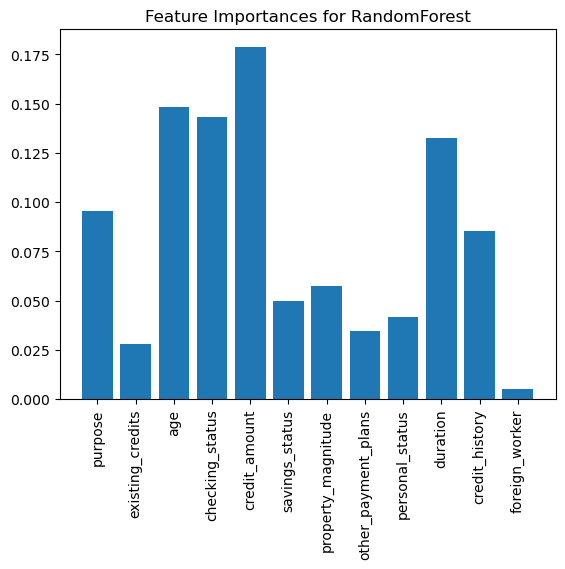

----------------------------------

Raport with scores for model DecisionTree:
----------------------------------
Model: DecisionTree
Parameters: {'max_depth': 10, 'min_samples_split': 10}
Score: 0.6553
Evaluation Metric: roc_auc
Training Time: 1.12 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.655292
1           accuracy  0.684268
2          precision  0.771841
3             recall  0.784079
4                 f1  0.776814
5  balanced_accuracy  0.617264
----------------------------------
Textual representation of the tree:
|--- checking_status <= 1.50
|   |--- duration <= 0.10
|   |   |--- age <= 0.00
|   |   |   |--- credit_history <= 0.50
|   |   |   |   |--- class: 0
|   |   |   |--- credit_history >  0.50
|   |   |   |   |--- credit_amount <= -0.69
|   |   |   |   |   |--- property_magnitude <= 0.50
|   |   |   |   |   |   |--- purpose <= 5.00
|   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |--- purpose >  5.00
|

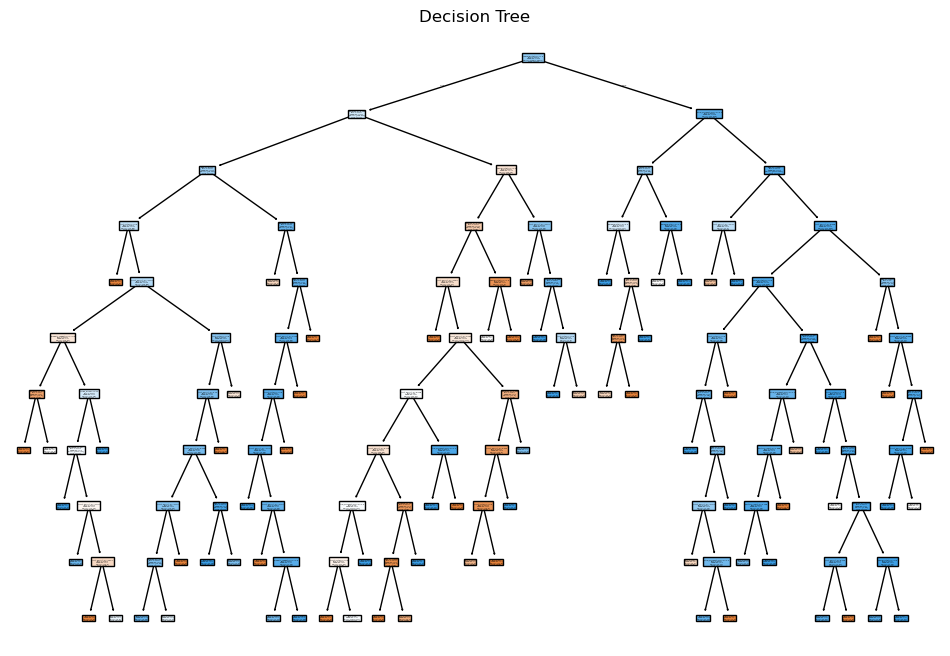

----------------------------------
Feature Importance:


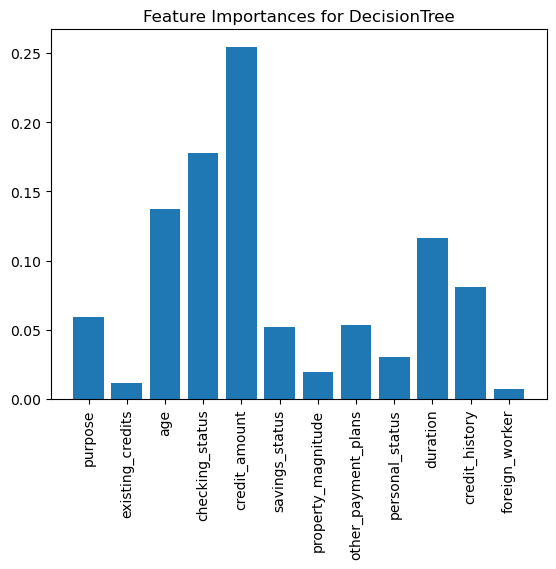

----------------------------------

Raport with scores for model XGBoost:
----------------------------------
Model: XGBoost
Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 200}
Score: 0.7636
Evaluation Metric: roc_auc
Training Time: 24.50 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.763631
1           accuracy  0.740001
2          precision  0.750438
3             recall  0.942990
4                 f1  0.835745
5  balanced_accuracy  0.603034
----------------------------------
Feature Importance:


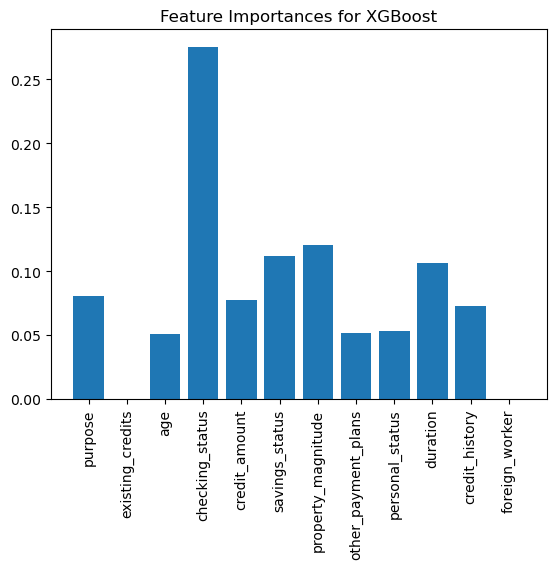

----------------------------------

Raport with scores for model GradientBoosting:
----------------------------------
Model: GradientBoosting
Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 200}
Score: 0.7656
Evaluation Metric: roc_auc
Training Time: 70.68 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.765620
1           accuracy  0.741413
2          precision  0.750030
3             recall  0.947005
4                 f1  0.836972
5  balanced_accuracy  0.602729
----------------------------------
Visualization of the first decision tree:


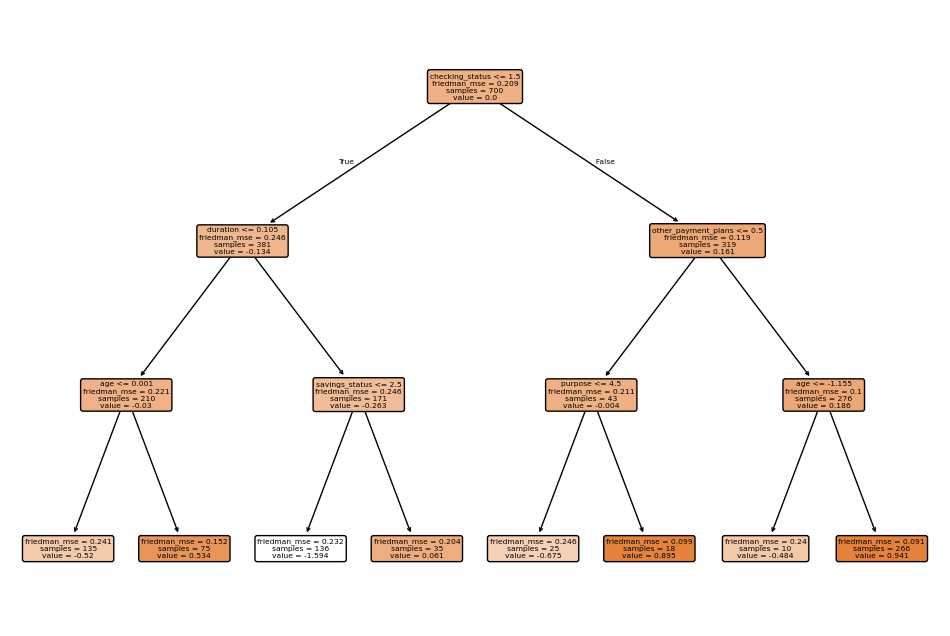

----------------------------------
Feature Importance:


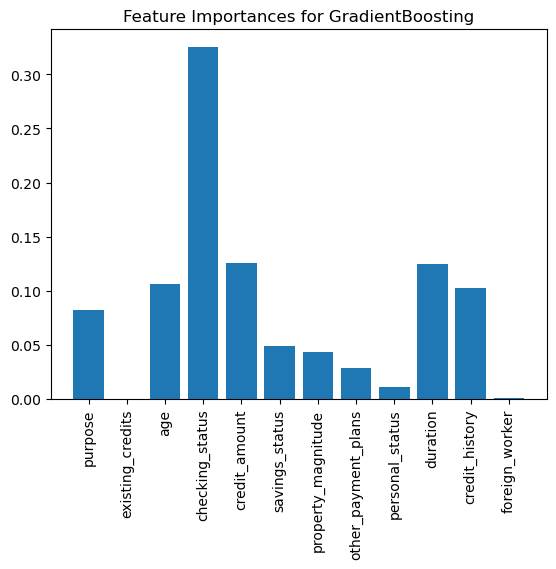

----------------------------------

Raport with scores for model LogisticRegression:
----------------------------------
Model: LogisticRegression
Parameters: {}
Score: 0.7128
Evaluation Metric:: roc_auc
Training Time: 0.32 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.712791
1           accuracy  0.708521
2          precision  0.744511
3             recall  0.890019
4                 f1  0.810730
5  balanced_accuracy  0.586142
----------------------------------
Model coefficients:
Coefficients for class bad:
  Feature: purpose,  Coefficient: 0.12171775771875269
  Feature: existing_credits,  Coefficient: -0.01375876234313147
  Feature: age,  Coefficient: 0.21144904471726345
  Feature: checking_status,  Coefficient: 0.44954098682055066
  Feature: credit_amount,  Coefficient: -0.14724077516750417
  Feature: savings_status,  Coefficient: 0.0842034878585794
  Feature: property_magnitude,  Coefficient: 0.055574535479687937
  Feature: other_

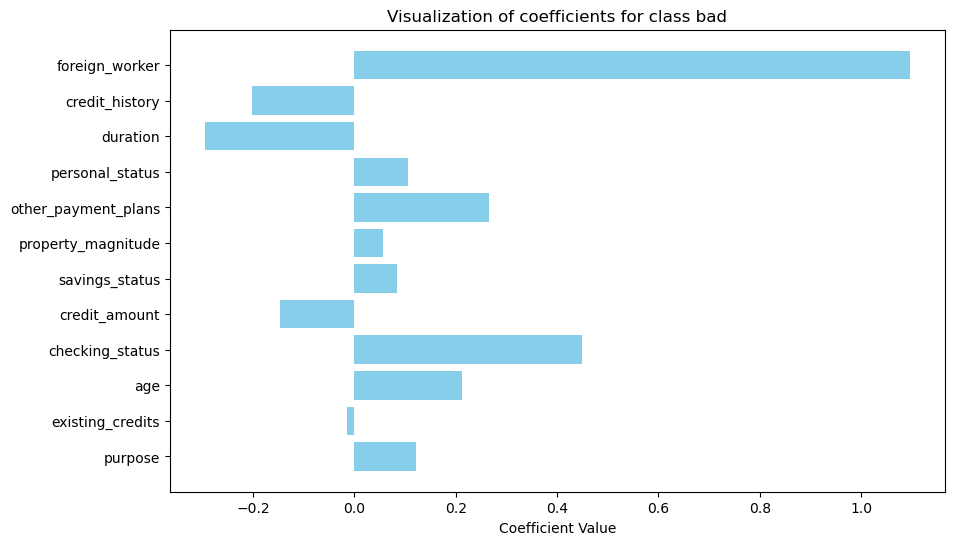

----------------------------------

Raport with scores for model LassoRegression:
----------------------------------
Model: LassoRegression
Parameters: {'C': 0.1}
Score: 0.7259
Evaluation Metric:: roc_auc
Training Time: 0.72 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.725878
1           accuracy  0.711419
2          precision  0.730599
3             recall  0.932864
4                 f1  0.819212
5  balanced_accuracy  0.562119
----------------------------------
Model coefficients:
Coefficients for class bad:
  Feature: purpose,  Coefficient: 0.11032633354671578
  Feature: existing_credits,  Coefficient: 0.0
  Feature: age,  Coefficient: 0.139286906934942
  Feature: checking_status,  Coefficient: 0.41255896310310547
  Feature: credit_amount,  Coefficient: -0.0789142046175041
  Feature: savings_status,  Coefficient: 0.02682299322269265
  Feature: property_magnitude,  Coefficient: 0.033363252461722656
  Feature: other_payment_plans,  C

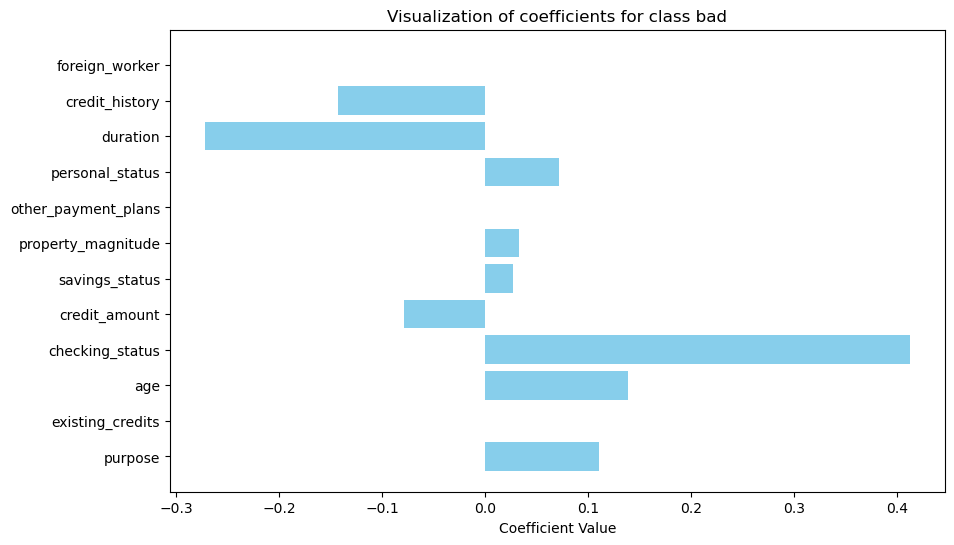

----------------------------------

Raport with scores for model RidgeRegression:
----------------------------------
Model: RidgeRegression
Parameters: {'C': 0.1}
Score: 0.7222
Evaluation Metric:: roc_auc
Training Time: 0.51 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.722199
1           accuracy  0.714256
2          precision  0.742248
3             recall  0.908374
4                 f1  0.816826
5  balanced_accuracy  0.583414
----------------------------------
Model coefficients:
Coefficients for class bad:
  Feature: purpose,  Coefficient: 0.12065816031379518
  Feature: existing_credits,  Coefficient: -0.007303441602851759
  Feature: age,  Coefficient: 0.19245920455406462
  Feature: checking_status,  Coefficient: 0.4276971567925525
  Feature: credit_amount,  Coefficient: -0.140464072550317
  Feature: savings_status,  Coefficient: 0.08355835783341249
  Feature: property_magnitude,  Coefficient: 0.0639895267477979
  Feature: other_p

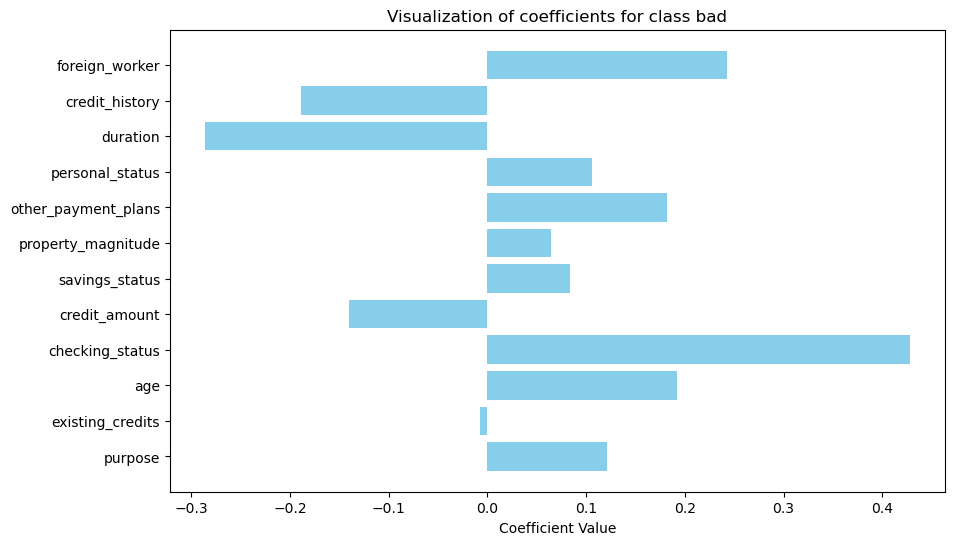

----------------------------------

Raport with scores for model LDA:
----------------------------------
Model: LDA
Parameters: {'solver': 'svd'}
Score: 0.7200
Evaluation Metric:: roc_auc
Training Time: 0.29 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.719977
1           accuracy  0.714238
2          precision  0.749537
3             recall  0.890019
4                 f1  0.813736
5  balanced_accuracy  0.595665
----------------------------------
Model coefficients:
Coefficients for class bad:
  Feature: purpose,  Coefficient: 0.12658663998725406
  Feature: existing_credits,  Coefficient: -0.04137161398734655
  Feature: age,  Coefficient: 0.19040550573433765
  Feature: checking_status,  Coefficient: 0.46874517191716036
  Feature: credit_amount,  Coefficient: -0.1664188354137699
  Feature: savings_status,  Coefficient: 0.07747852026207204
  Feature: property_magnitude,  Coefficient: 0.05704294815258199
  Feature: other_payment_plans,  

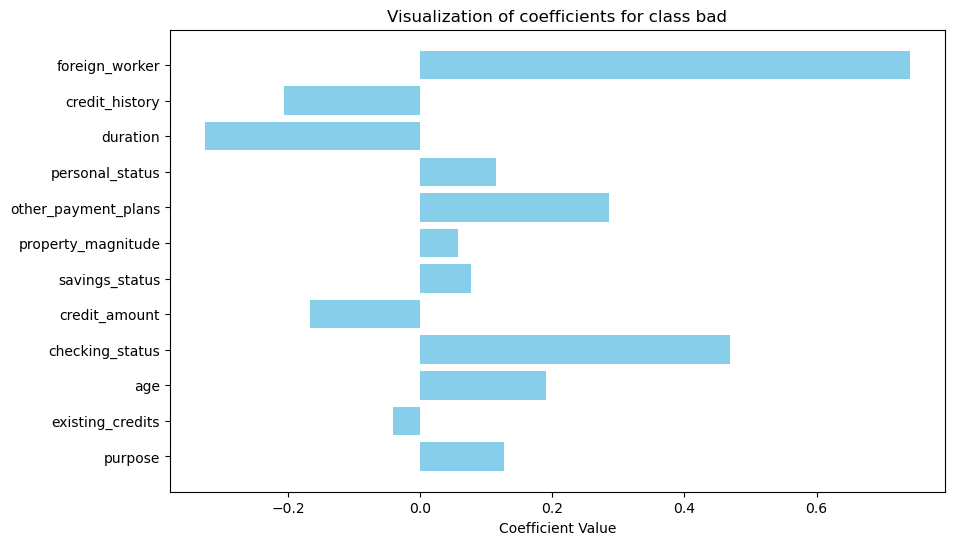

----------------------------------
Means and covariance matrix:
Means: [[ 3.98086124 -0.08050218 -0.21147402  1.01435407  0.2475927   2.02392344
   1.25837321  0.86602871  1.66985646  0.30263658  2.4354067   0.01435407]
 [ 4.80448065  0.03426671  0.09001643  1.80244399 -0.10539078  2.20162933
   1.43380855  0.91242363  1.96130346 -0.12882087  2.10794297  0.04887984]]
Covariance matrix: [[ 5.65307655e+00 -1.13726966e-01  9.75606123e-02  1.67274342e-01
   1.54473049e-01  2.46360156e-01 -1.29029837e-01  1.57954041e-02
   2.34235083e-01  2.11681529e-03  8.72021750e-03 -1.46430277e-02]
 [-1.13726966e-01  9.97241455e-01  1.42047359e-01  8.24596862e-02
   2.29929243e-02  1.43043207e-03  7.72739389e-03 -6.47277219e-03
   2.18998820e-01 -1.92537990e-02 -3.76699621e-01  7.92188456e-04]
 [ 9.75606123e-02  1.42047359e-01  9.80963863e-01  8.38022728e-02
   5.35954974e-02  8.99983455e-02  1.63401500e-01 -1.81751624e-02
   2.06507105e-01 -7.94026217e-03 -1.94400061e-01 -4.40411388e-04]
 [ 1.67274342e

In [8]:
# Training models and generating report
pipeline.train(X_train, y_train)

In [9]:
# Generating a summary report for the training phase
pipeline.summary

,duration,credit_amount,installment_commitment,residence_since,age,existing_credits,num_dependents
count,700.000000,700.000000,700.000000,700.000000,700.000000,700.000000,700.000000
mean,21.252857,3406.815714,2.981429,2.834286,35.492857,1.420000,1.137143
std,11.900051,2971.897408,1.118679,1.103238,11.253037,0.581695,0.344244
min,4.000000,250.000000,1.000000,1.000000,19.000000,1.000000,1.000000
25%,12.000000,1381.750000,2.000000,2.000000,27.000000,1.000000,1.000000
50%,18.000000,2332.000000,3.000000,3.000000,33.000000,1.000000,1.000000
75%,24.000000,4226.000000,4.000000,4.000000,42.000000,2.000000,1.000000
max,60.000000,18424.000000,4.000000,4.000000,75.000000,4.000000,2.000000


#### Step 4: Summarizing and making predictions on new data

In [10]:
# Additional outputs to inspect
print("Unique Values in Target:", pipeline.unique_values)
print("Final Selected Features:", pipeline.final_features)
print("Training Results Summary:")
print(pipeline.results)

Unique Values in Target: ['bad', 'good']
Final Selected Features: ['purpose', 'existing_credits', 'age', 'checking_status', 'credit_amount', 'savings_status', 'property_magnitude', 'other_payment_plans', 'personal_status', 'duration', 'credit_history', 'foreign_worker']
Training Results Summary:
[('RandomForest', {'max_depth': 10, 'min_samples_split': 5, 'n_estimators': 100}, 0.7727104334545993, 'roc_auc', 25.657588005065918), ('DecisionTree', {'max_depth': 10, 'min_samples_split': 10}, 0.6552915904687759, 'roc_auc', 1.1203818321228027), ('XGBoost', {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 200}, 0.7636306912453722, 'roc_auc', 24.498422622680664), ('GradientBoosting', {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 200}, 0.7656199028219373, 'roc_auc', 70.68381309509277), ('LogisticRegression', {}, 0.7127910661322824, 'roc_auc', 0.3245835304260254), ('LassoRegression', {'C': 0.1}, 0.7258777640742914, 'roc_auc', 0.7185144424438477), ('RidgeRegression', {'C': 0.1}, 0

In [11]:
pipeline.scores['RandomForest']

,Metric,Result
0,roc_auc,0.772710
1,accuracy,0.751421
2,precision,0.775703
3,recall,0.908350
4,f1,0.836775
5,balanced_accuracy,0.645548


In [12]:
pipeline.optimizers['RandomForest']

RandomForestClassifier(max_depth=10, min_samples_split=5, random_state=2024)

In [13]:
pipeline.all_results

,Model_Name,Best_Params,Best_Score,Eval_Scoring,Training_Time
0,RandomForest,"{'max_depth': 10, 'min_samples_split': 5, 'n_e...",0.7727,roc_auc,25.66 seconds
1,DecisionTree,"{'max_depth': 10, 'min_samples_split': 10}",0.6553,roc_auc,1.12 seconds
2,XGBoost,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",0.7636,roc_auc,24.50 seconds
3,GradientBoosting,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est...",0.7656,roc_auc,70.68 seconds
4,LogisticRegression,{},0.7128,roc_auc,0.32 seconds
5,LassoRegression,{'C': 0.1},0.7259,roc_auc,0.72 seconds
6,RidgeRegression,{'C': 0.1},0.7222,roc_auc,0.51 seconds
7,LDA,{'solver': 'svd'},0.7200,roc_auc,0.29 seconds
8,QDA,{'reg_param': 0.01},0.7232,roc_auc,0.28 seconds


In [14]:
pipeline.predict(X_test, model_name = 'XGBoost')

array([1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,
       1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1,
       1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0])

In [15]:
pipeline.predict_proba(X_test, model_name = 'QDA')

array([[3.73785356e-01, 6.26214644e-01],
       [3.28862472e-01, 6.71137528e-01],
       [9.20525429e-01, 7.94745713e-02],
       [1.56560814e-01, 8.43439186e-01],
       [3.28897893e-02, 9.67110211e-01],
       [1.41247346e-01, 8.58752654e-01],
       [1.59336150e-01, 8.40663850e-01],
       [3.84872323e-01, 6.15127677e-01],
       [2.34624003e-08, 9.99999977e-01],
       [3.02665070e-01, 6.97334930e-01],
       [3.71691803e-01, 6.28308197e-01],
       [4.72284503e-01, 5.27715497e-01],
       [5.89612662e-02, 9.41038734e-01],
       [9.63963224e-01, 3.60367757e-02],
       [9.78632752e-01, 2.13672480e-02],
       [4.69650684e-01, 5.30349316e-01],
       [3.99526747e-02, 9.60047325e-01],
       [2.30927584e-03, 9.97690724e-01],
       [2.72391502e-01, 7.27608498e-01],
       [4.61514248e-01, 5.38485752e-01],
       [6.38761365e-02, 9.36123864e-01],
       [3.61549935e-01, 6.38450065e-01],
       [1.56181940e-01, 8.43818060e-01],
       [2.43447697e-02, 9.75655230e-01],
       [5.895496

#### Generating report on test dataset

Testing Results:

Report with scores for model RandomForest on the test set:
----------------------------------
Metric values on the test set:
              Metric   Score
0           accuracy  0.6300
1          precision  0.7552
2             recall  0.6938
3                 f1  0.7232
4  balanced_accuracy  0.5886
5                AUC  0.6051
----------------------------------
ROC Curve:


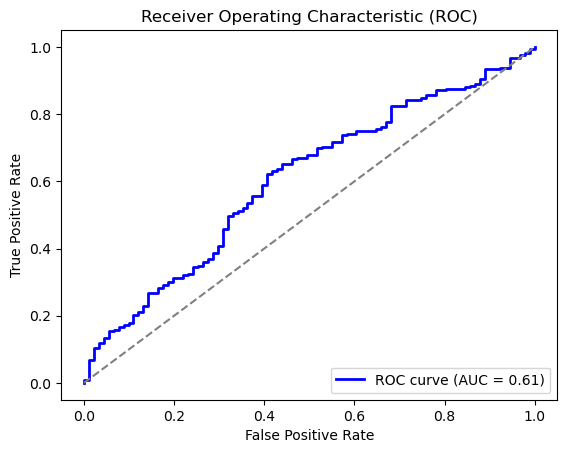

----------------------------------
Confusion Matrix for threshold 0.6:


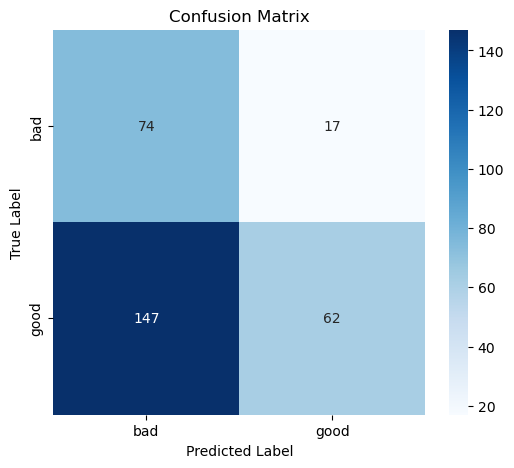

----------------------------------
Other metrics:
Mean Gini: 0.4757
Mean Entropy: 0.9642
----------------------------------


In [16]:
# Predictions and evaluation on test data
print("Testing Results:")
pipeline.predict_and_report(X_test, y_test, prediction_threshold = 0.6)

### Example of using the package for multiclass classification

#### Step 1: Loading and Exploring Data

In [17]:
import seaborn as sns
import pandas as pd

# Loading sample dataset
diamonds = sns.load_dataset("diamonds")
diamonds = pd.DataFrame(diamonds).iloc[:1000, :]

y = diamonds.cut
X = diamonds.drop(["cut"], axis=1)

In [18]:
from sklearn.model_selection import train_test_split

# Splitting into train and test datasets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [19]:
# Displaying data sample and target distribution
print("Training Data Sample:")
print(X_train.head())
print("Training Target Distribution:")
print(y_train.value_counts())

print("Testing Data Sample:")
print(X_test.head())
print("Testing Target Distribution:")
print(y_test.value_counts())

Training Data Sample:
     carat color clarity  depth  table  price     x     y     z
541   0.70     D     SI2   60.6   57.0   2828  5.74  5.77  3.49
440   0.95     F     SI2   56.0   60.0   2815  6.62  6.53  3.68
482   0.73     E     SI1   63.6   57.0   2821  5.72  5.70  3.63
422   0.71     D     SI1   62.4   57.0   2812  5.69  5.72  3.56
778   0.83     E     SI2   59.2   60.0   2859  6.17  6.12  3.64
Training Target Distribution:
cut
Ideal        233
Premium      207
Very Good    155
Good          62
Fair          43
Name: count, dtype: int64
Testing Data Sample:
     carat color clarity  depth  table  price     x     y     z
521   0.71     G     VS1   62.2   59.0   2825  5.73  5.66  3.54
737   0.31     H     VS1   61.6   54.8    557  4.35  4.37  2.69
740   0.33     F     SI2   62.3   58.0    557  4.43  4.40  2.75
660   0.79     D     SI1   61.5   56.0   2846  5.96  5.91  3.65
411   0.34     I     VS1   62.0   56.0    555  4.50  4.53  2.80
Testing Target Distribution:
cut
Ideal      

#### Step 2: Creating and Configuring AutoFinancer Object

In [20]:
from autofinancer import AutoFinancer

pipeline = AutoFinancer(problem_type = 'multiclass_classification')

#### Step 3: Training Models

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\feature_selection\_univariate_selection.py:776: UserWarning:

k=10 is greater than n_features=6. All the features will be returned.



Training model: RandomForest
Preparation of a new explainer is initiated

  -> data              : 700 rows 6 cols
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.RandomizedSearchCV (default)
  -> label             : RandomForest
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.0176, mean = 0.0877, max = 0.65
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.263, mean = 2.44, max = 3.98
  -> model_info        : package sklearn

A new explainer has been created!
Training model: DecisionTree


C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\multiclass.py:551: RuntimeWarning:

invalid value encountered in divide

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\model_selection\_validation.py:1000: UserWarning:

Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 139, in __call__
    score = scorer._score(
            ^^^^^^^^^^^^^^
  File "C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\metrics\_scorer.py", line 376, in _score
    return self._sign * self._score_func(y_true, y_pred, **scoring_kwargs)
                        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\utils\_param_validation.py", line 213, in wrapper
    return func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\metri

Preparation of a new explainer is initiated

  -> data              : 700 rows 6 cols
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.RandomizedSearchCV (default)
  -> label             : DecisionTree
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.0155, mean = 0.0863, max = 0.962
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.283, mean = 2.44, max = 3.98
  -> model_info        : package sklearn

A new explainer has been created!
Training model: XGBoost
Preparation of a new explainer is initiated

  -> data              : 700 rows 6 cols
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.RandomizedSearchCV (default)
  -> label          

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning:

The total space of parameters 1 is smaller than n_iter=10. Running 1 iterations. For exhaustive searches, use GridSearchCV.

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



Preparation of a new explainer is initiated

  -> data              : 700 rows 6 cols
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.RandomizedSearchCV (default)
  -> label             : LogisticRegression
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.0029, mean = 0.0914, max = 0.392
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.37, mean = 2.44, max = 3.99
  -> model_info        : package sklearn

A new explainer has been created!
Training model: LassoRegression


C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



Preparation of a new explainer is initiated

  -> data              : 700 rows 6 cols
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.RandomizedSearchCV (default)
  -> label             : LassoRegression
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.00551, mean = 0.0916, max = 0.4
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.4, mean = 2.44, max = 3.99
  -> model_info        : package sklearn

A new explainer has been created!
Training model: RidgeRegression


C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:349: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

C:\Users\XXX\anaconda3\Lib\site-pa

Preparation of a new explainer is initiated

  -> data              : 700 rows 6 cols
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.RandomizedSearchCV (default)
  -> label             : RidgeRegression
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.00446, mean = 0.0906, max = 0.399
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.399, mean = 2.44, max = 3.99
  -> model_info        : package sklearn

A new explainer has been created!
Training model: LDA


C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning:

The total space of parameters 3 is smaller than n_iter=10. Running 3 iterations. For exhaustive searches, use GridSearchCV.



Preparation of a new explainer is initiated

  -> data              : 700 rows 6 cols
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.RandomizedSearchCV (default)
  -> label             : LDA
  -> predict function  : <function yhat_proba_default at 0x000001F35C2C4B80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.00311, mean = 0.0885, max = 0.433
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -0.398, mean = 2.44, max = 3.99
  -> model_info        : package sklearn

A new explainer has been created!
Training model: QDA
Preparation of a new explainer is initiated

  -> data              : 700 rows 6 cols
  -> target variable   : 700 values
  -> model_class       : sklearn.model_selection._search.RandomizedSearchCV (default)
  -> label             : QDA
  -

None
----------------------------------
Partial dependence profiles (PDP):


Calculating ceteris paribus: 100%|██████████| 6/6 [00:00<00:00, 16.93it/s]


None
----------------------------------
Accumulated local dependence profiles (ALE):


Calculating accumulated dependency: 100%|██████████| 6/6 [00:00<00:00,  6.22it/s]


None
----------------------------------

Raport with scores for model RandomForest:
----------------------------------
Model: RandomForest
Parameters: {'estimator__n_estimators': 417, 'estimator__min_samples_split': 10, 'estimator__max_depth': 4}
Score: 0.6857
Evaluation Metric: accuracy
Training Time: 227.41 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.871423
1           accuracy  0.685714
2          precision  0.698545
3             recall  0.647000
4                 f1  0.634009
5  balanced_accuracy  0.647000
----------------------------------
Visualization of the first decision tree:


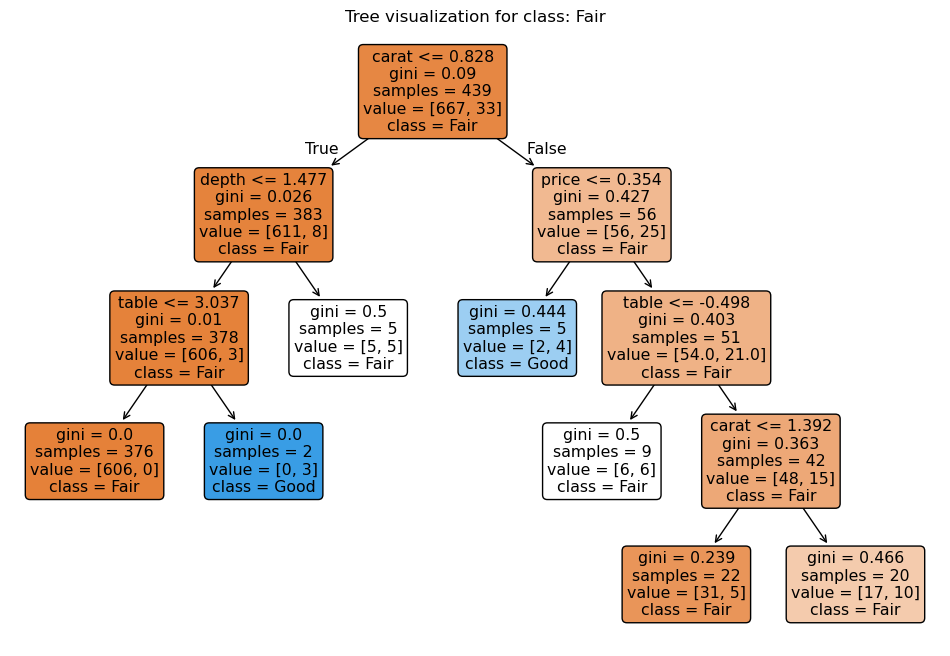

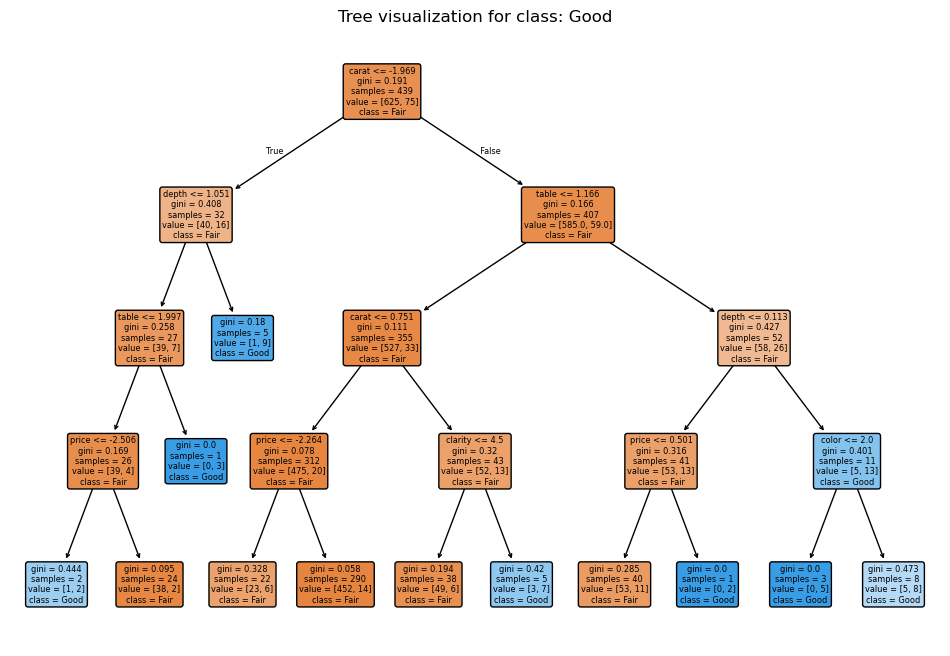

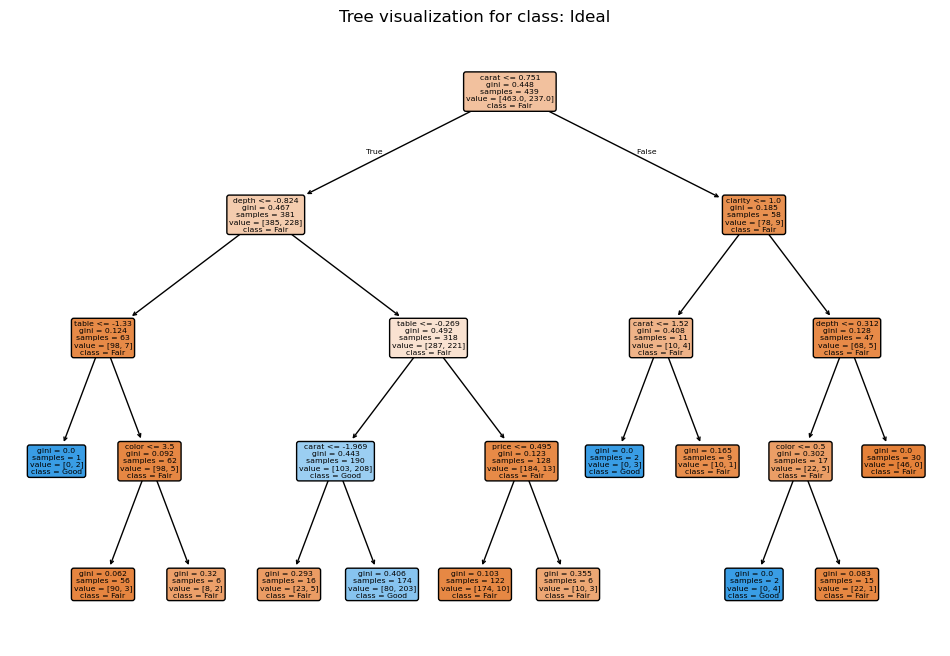

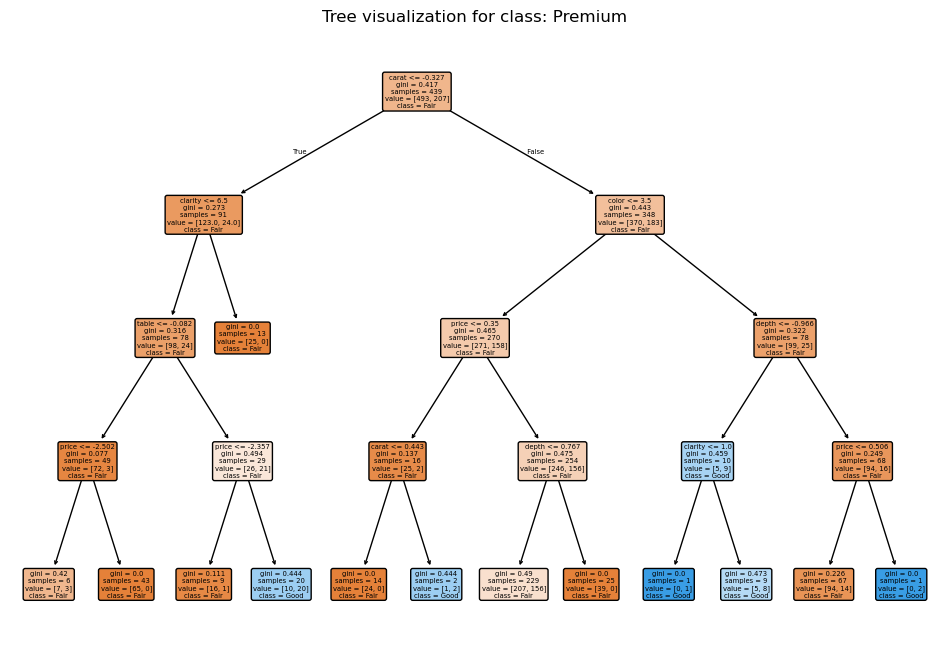

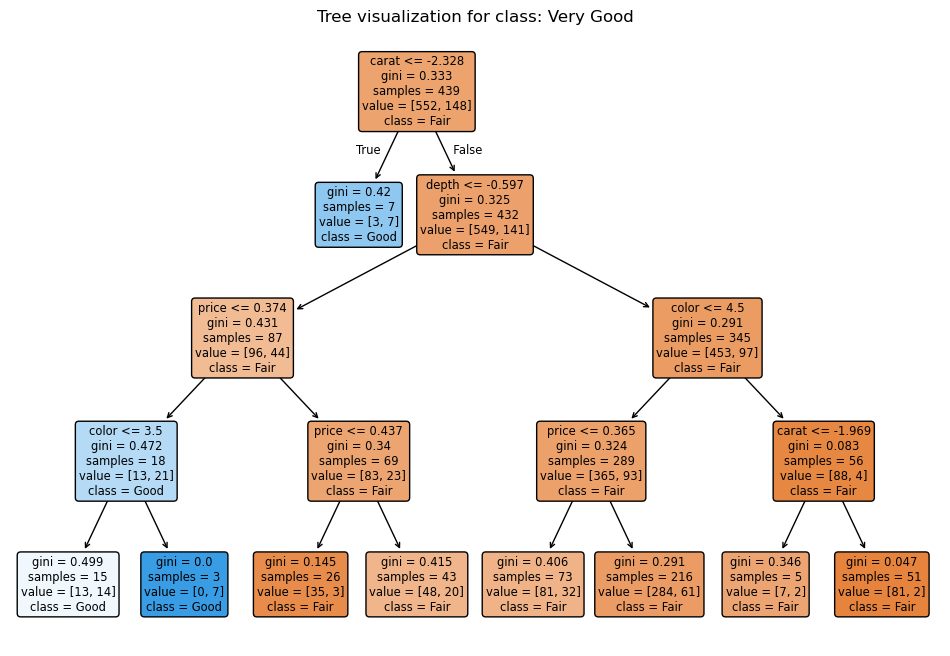

----------------------------------
Feature Importance:


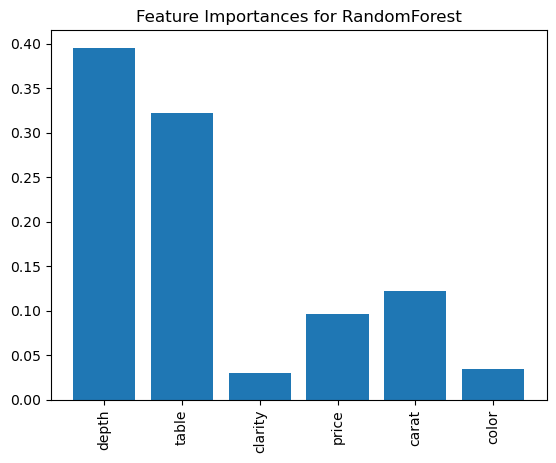

----------------------------------

Raport with scores for model DecisionTree:
----------------------------------
Model: DecisionTree
Parameters: {'estimator__min_samples_split': 9, 'estimator__max_depth': 2}
Score: 0.6800
Evaluation Metric: accuracy
Training Time: 3.26 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.843827
1           accuracy  0.680000
2          precision  0.683483
3             recall  0.642057
4                 f1  0.616307
5  balanced_accuracy  0.642057
----------------------------------
Textual representation of the tree:
Rules for class Fair:
|--- depth <= 1.51
|   |--- depth <= -2.56
|   |   |--- class: 1
|   |--- depth >  -2.56
|   |   |--- class: 0
|--- depth >  1.51
|   |--- carat <= 0.93
|   |   |--- class: 1
|   |--- carat >  0.93
|   |   |--- class: 1

----------------------------------
Rules for class Good:
|--- depth <= 0.88
|   |--- table <= 2.00
|   |   |--- class: 0
|   |--- table >  2.00
|   |   |--

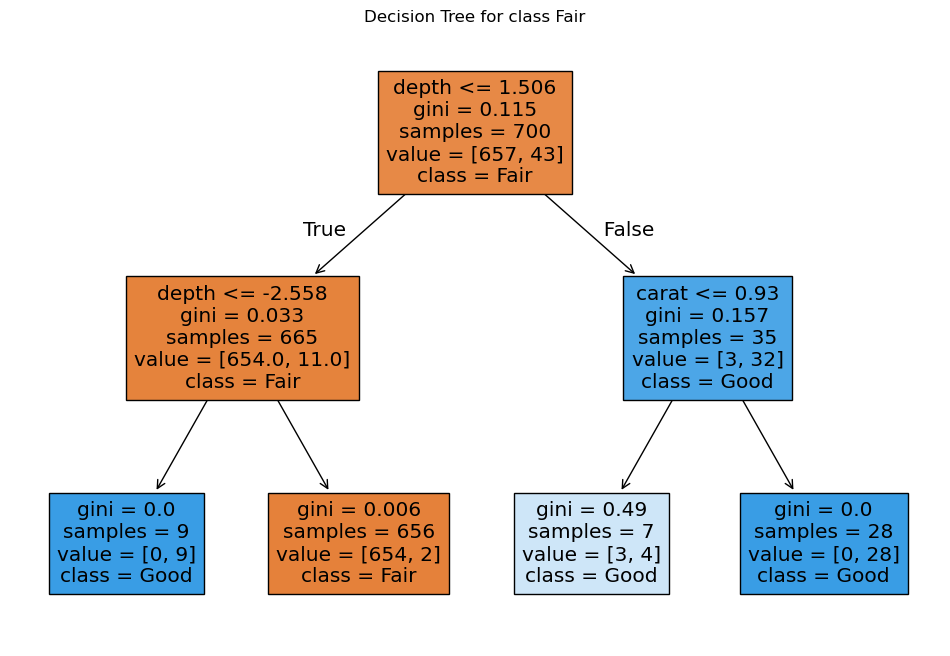

Plotting tree for class Good:


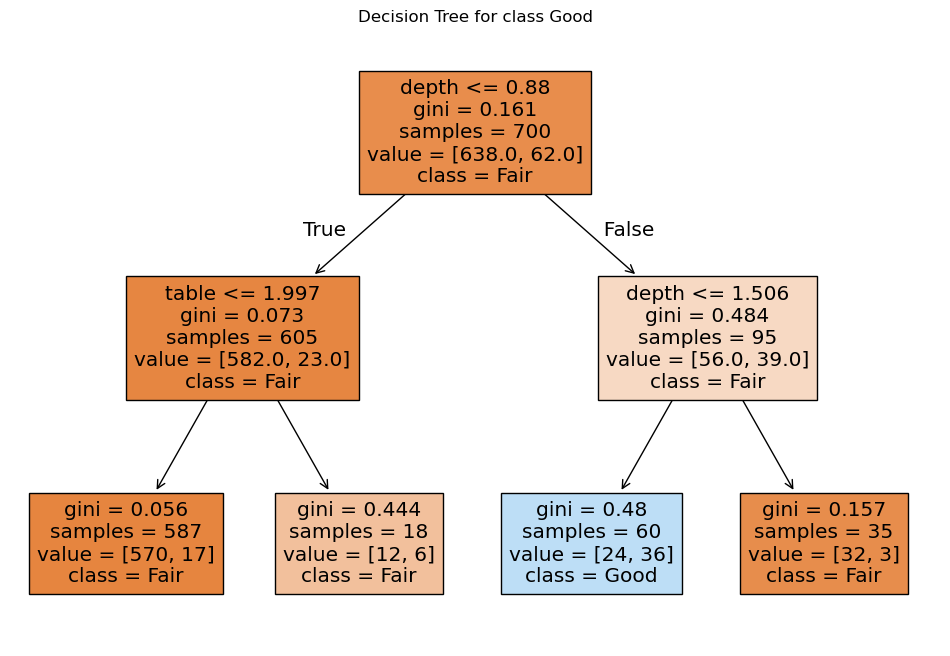

Plotting tree for class Ideal:


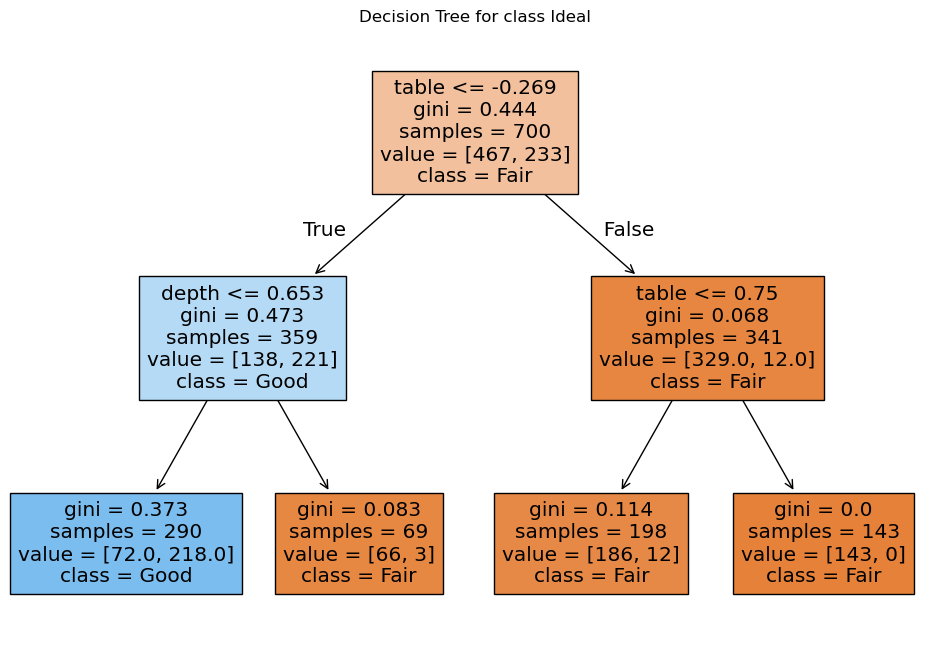

Plotting tree for class Premium:


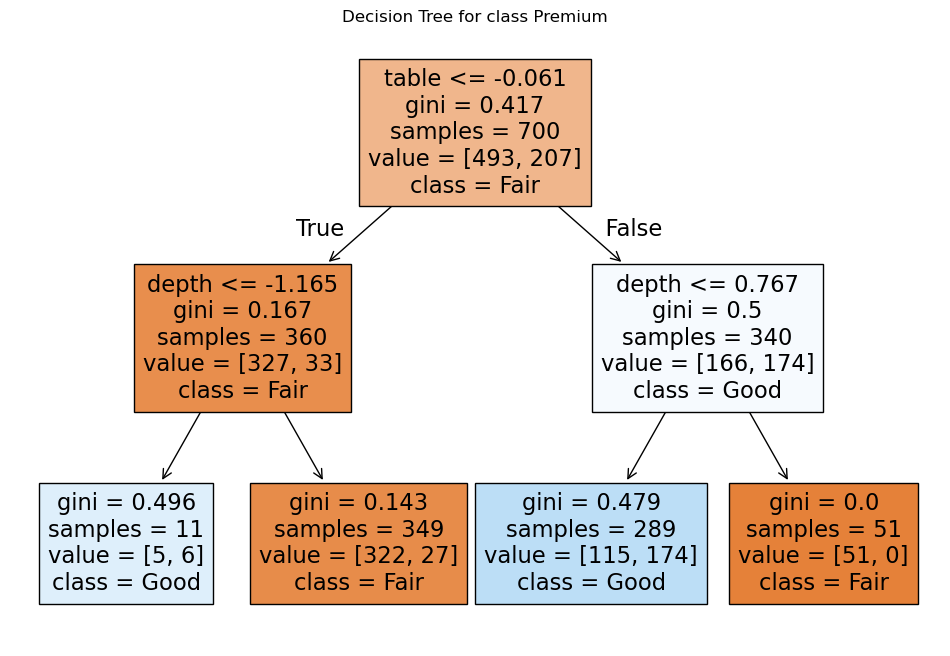

Plotting tree for class Very Good:


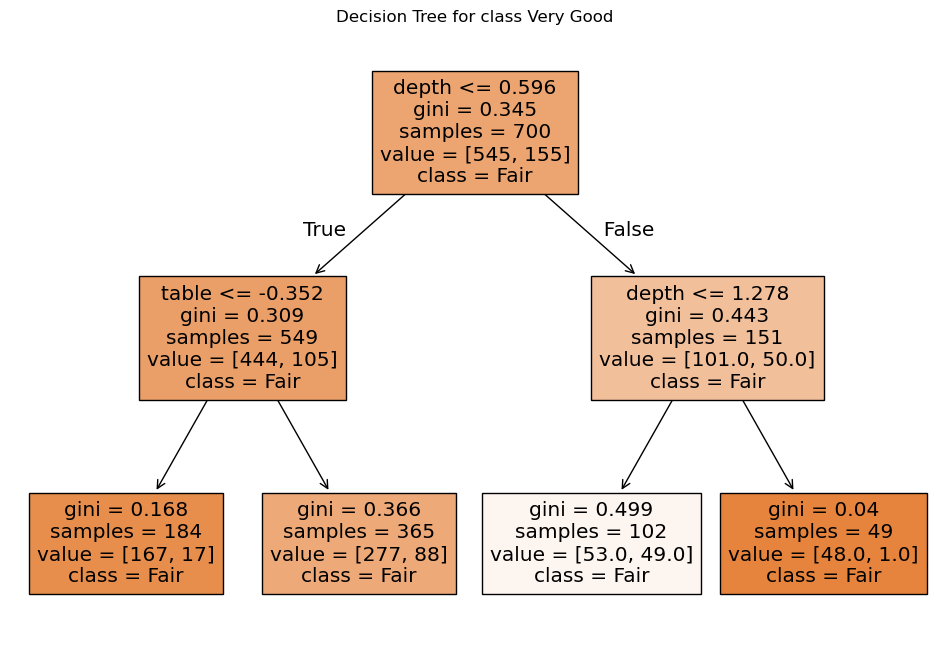

----------------------------------
Feature Importance:


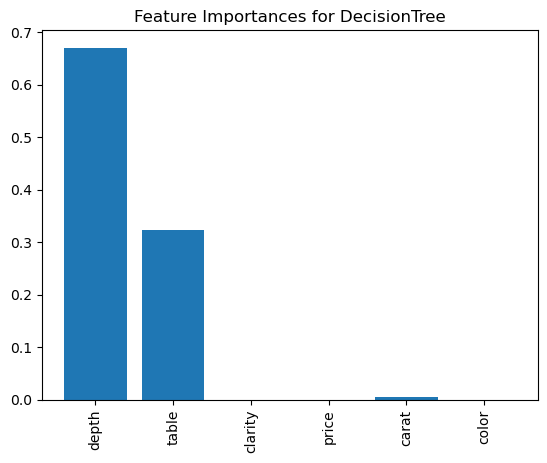

----------------------------------

Raport with scores for model XGBoost:
----------------------------------
Model: XGBoost
Parameters: {'estimator__learning_rate': 0.0061751603887259315, 'estimator__max_depth': 2, 'estimator__n_estimators': 151}
Score: 0.6871
Evaluation Metric: accuracy
Training Time: 106.74 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.857458
1           accuracy  0.687143
2          precision  0.710821
3             recall  0.657395
4                 f1  0.637792
5  balanced_accuracy  0.657395
----------------------------------
Feature Importance:


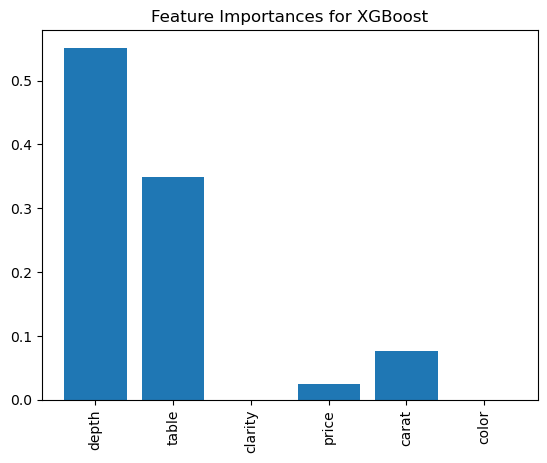

----------------------------------

Raport with scores for model GradientBoosting:
----------------------------------
Model: GradientBoosting
Parameters: {'estimator__learning_rate': 0.0061751603887259315, 'estimator__max_depth': 2, 'estimator__n_estimators': 151}
Score: 0.6900
Evaluation Metric: accuracy
Training Time: 281.97 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.857263
1           accuracy  0.690000
2          precision  0.722334
3             recall  0.656434
4                 f1  0.643589
5  balanced_accuracy  0.656434
----------------------------------
Visualization of the first decision tree:


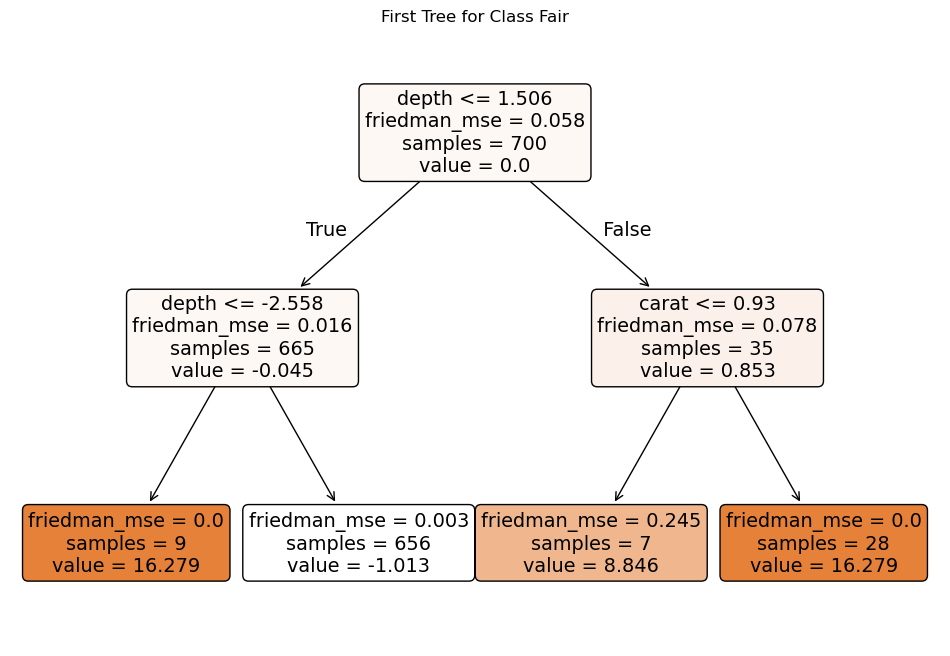

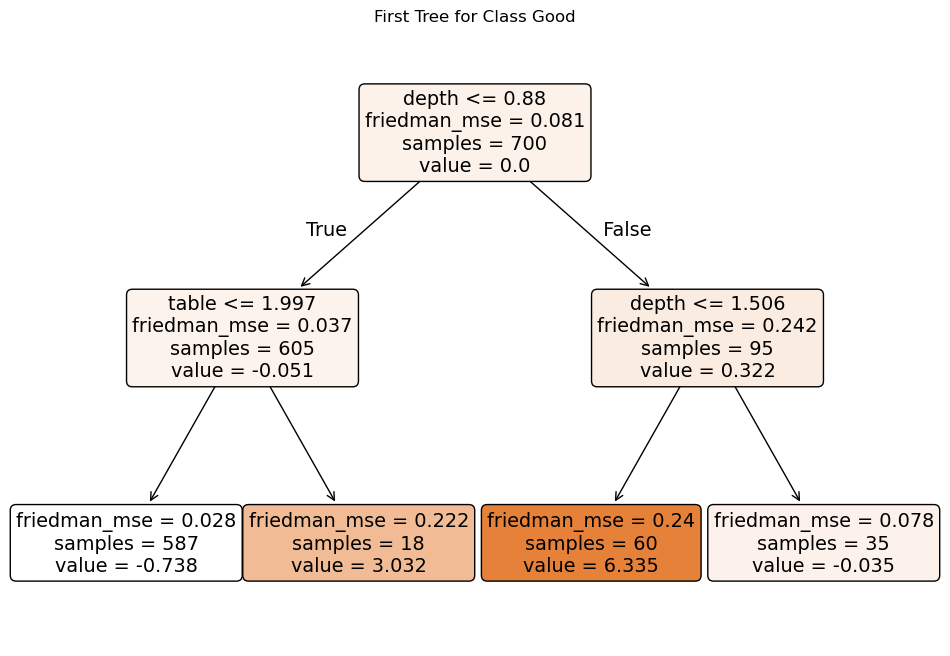

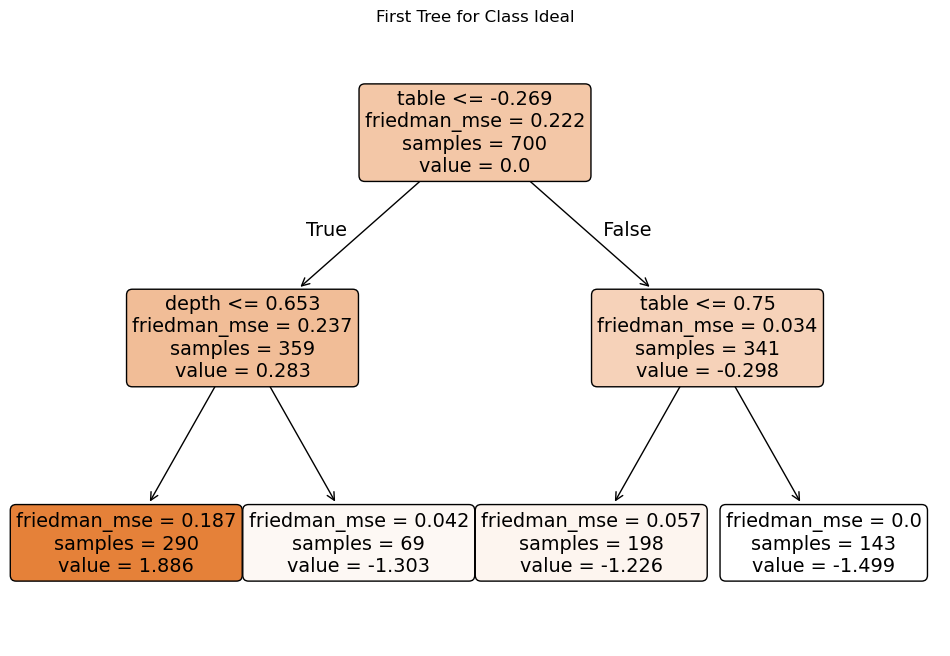

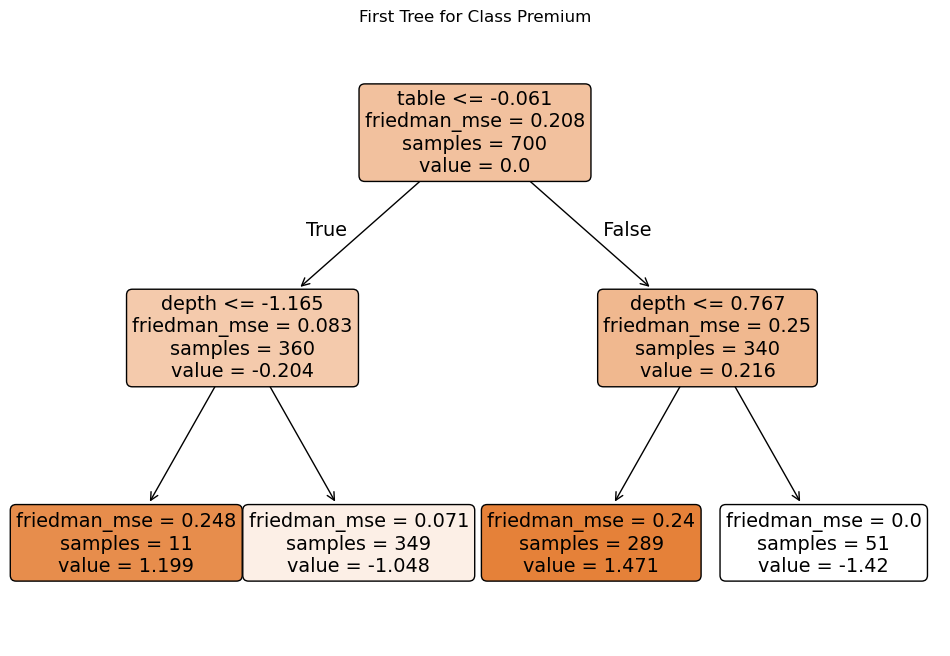

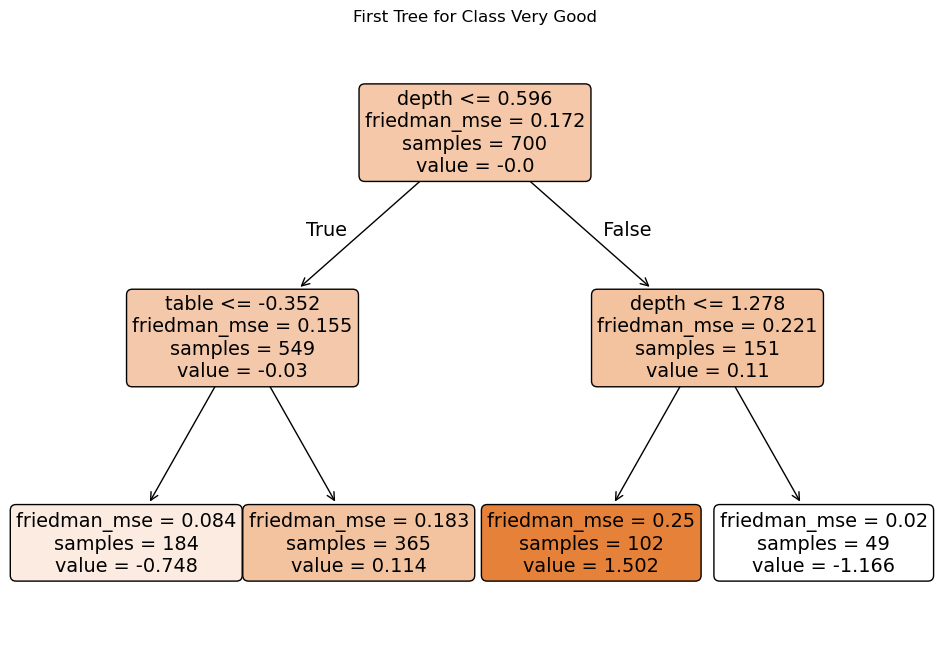

----------------------------------
Feature Importance:


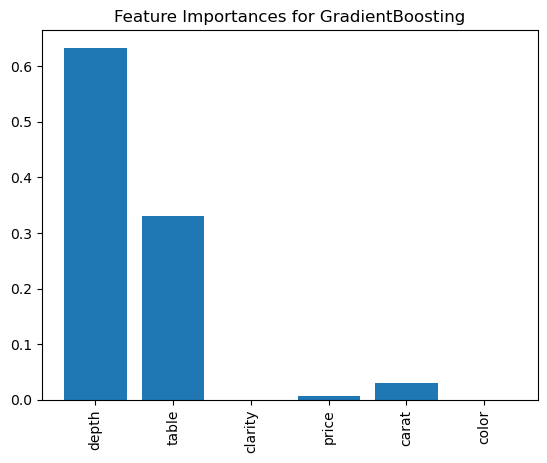

----------------------------------

Raport with scores for model LogisticRegression:
----------------------------------
Model: LogisticRegression
Parameters: {}
Score: 0.5814
Evaluation Metric:: accuracy
Training Time: 0.48 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.773850
1           accuracy  0.581429
2          precision  0.481847
3             recall  0.466187
4                 f1  0.444796
5  balanced_accuracy  0.466187
----------------------------------
Model coefficients:
Coefficients for class Fair:
  Feature: depth,  Coefficient: 1.0179875227903685
  Feature: table,  Coefficient: 1.4669419575079463
  Feature: clarity,  Coefficient: 0.3248490538026157
  Feature: price,  Coefficient: -1.791820082325188
  Feature: carat,  Coefficient: 2.5097840664899347
  Feature: color,  Coefficient: -0.3233654288462307
Intercept for class Fair: -4.803003784045281
----------------------------------
Visualization of coefficients:


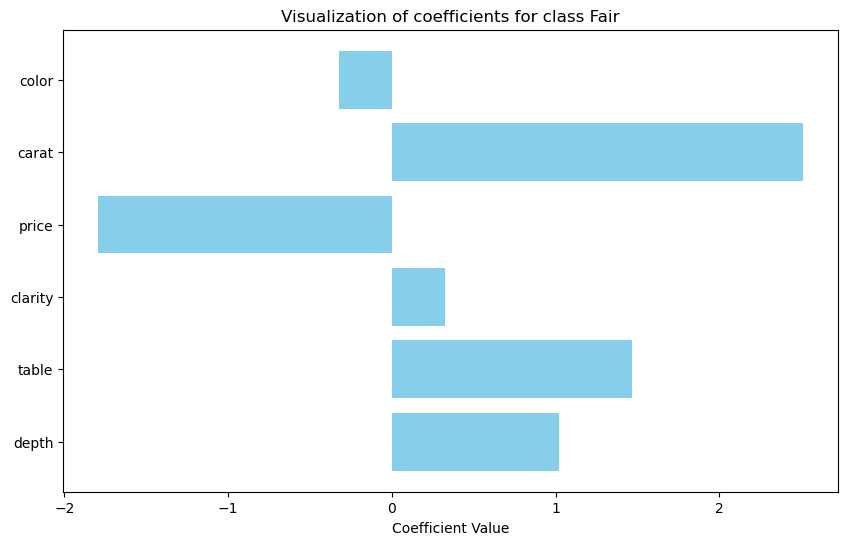

Coefficients for class Good:
  Feature: depth,  Coefficient: 0.7344670562220287
  Feature: table,  Coefficient: 0.4703610855888768
  Feature: clarity,  Coefficient: 0.009746653446591862
  Feature: price,  Coefficient: -0.06907516846951274
  Feature: carat,  Coefficient: -0.3918314391826014
  Feature: color,  Coefficient: 0.022929815920257137
Intercept for class Good: -2.6832493366666523
----------------------------------
Visualization of coefficients:


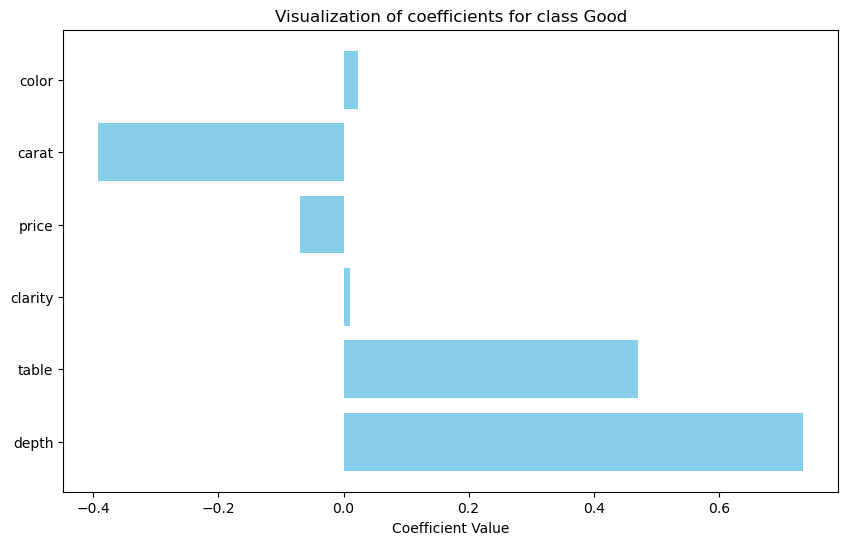

Coefficients for class Ideal:
  Feature: depth,  Coefficient: -0.9452412391521259
  Feature: table,  Coefficient: -2.4697681705523182
  Feature: clarity,  Coefficient: -0.15928574988528676
  Feature: price,  Coefficient: 1.4320175149844363
  Feature: carat,  Coefficient: -1.3131893230506333
  Feature: color,  Coefficient: 0.2630045610496214
Intercept for class Ideal: -1.4715902952832662
----------------------------------
Visualization of coefficients:


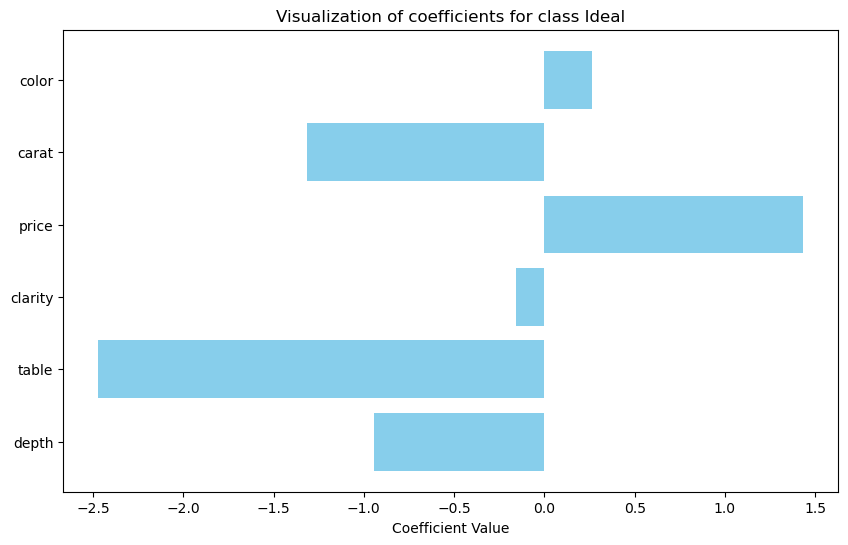

Coefficients for class Premium:
  Feature: depth,  Coefficient: -0.299840861095628
  Feature: table,  Coefficient: 0.557095722987369
  Feature: clarity,  Coefficient: 0.030991337723349183
  Feature: price,  Coefficient: -0.144245655067293
  Feature: carat,  Coefficient: 0.23696802326689803
  Feature: color,  Coefficient: -0.07180321660380858
Intercept for class Premium: -0.8883525121247294
----------------------------------
Visualization of coefficients:


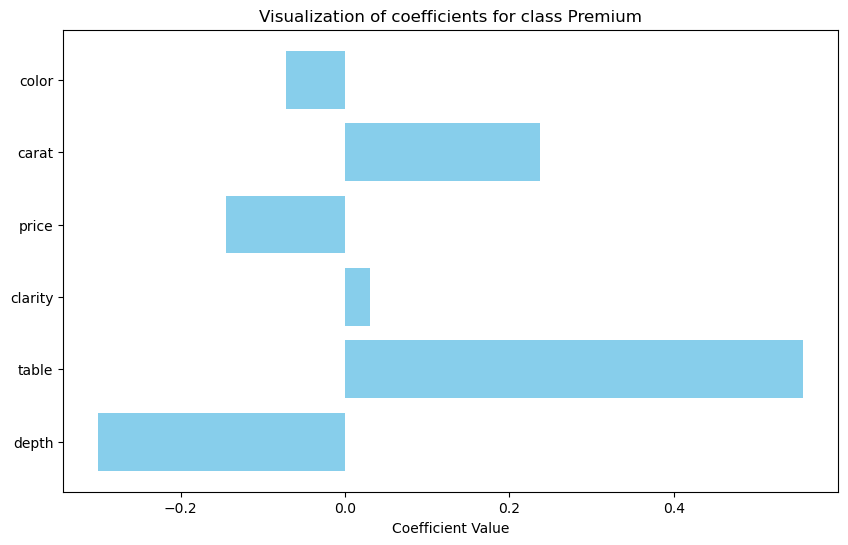

Coefficients for class Very Good:
  Feature: depth,  Coefficient: 0.2004201488409105
  Feature: table,  Coefficient: 0.2925983763755494
  Feature: clarity,  Coefficient: -0.011833388476320917
  Feature: price,  Coefficient: 0.13306359544980872
  Feature: carat,  Coefficient: -0.33760458317940434
  Feature: color,  Coefficient: -0.09669078181881086
Intercept for class Very Good: -1.0257108974737286
----------------------------------
Visualization of coefficients:


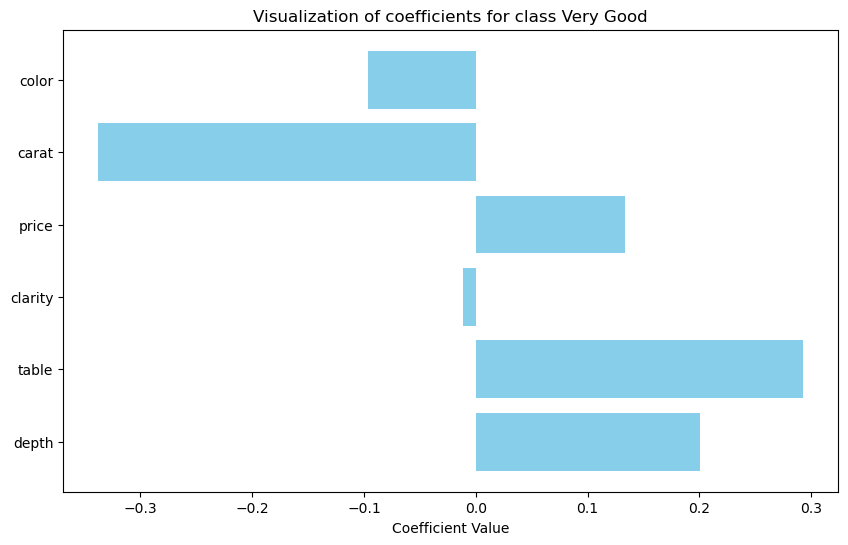

----------------------------------

Raport with scores for model LassoRegression:
----------------------------------
Model: LassoRegression
Parameters: {'estimator__C': 0.2998569147310718}
Score: 0.5957
Evaluation Metric:: accuracy
Training Time: 4.41 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.768435
1           accuracy  0.595714
2          precision  0.524361
3             recall  0.478021
4                 f1  0.455536
5  balanced_accuracy  0.478021
----------------------------------
Model coefficients:
Coefficients for class Fair:
  Feature: depth,  Coefficient: 0.862028332578892
  Feature: table,  Coefficient: 1.236287570530402
  Feature: clarity,  Coefficient: 0.0
  Feature: price,  Coefficient: 0.0
  Feature: carat,  Coefficient: 1.1947900200953554
  Feature: color,  Coefficient: -0.030760837016128764
Intercept for class Fair: -3.9872349481918326
----------------------------------
Visualization of coefficients:


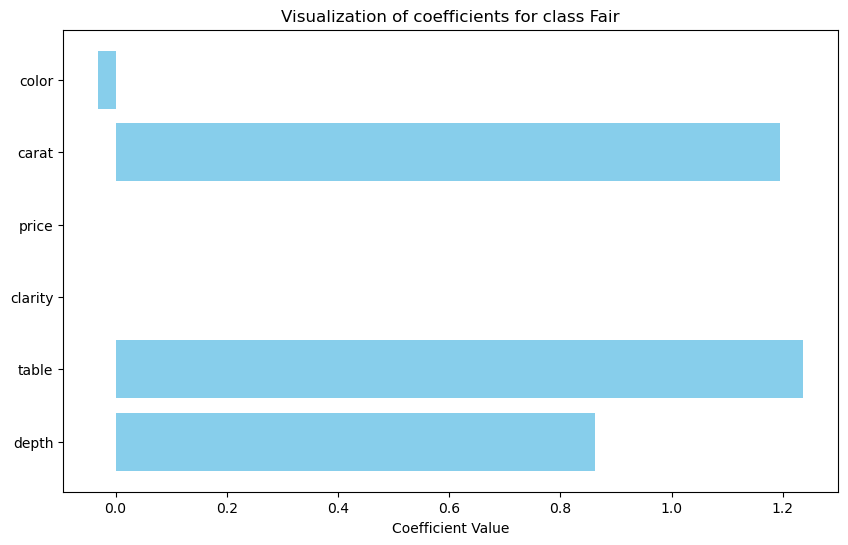

Coefficients for class Good:
  Feature: depth,  Coefficient: 0.6174342066658638
  Feature: table,  Coefficient: 0.36143372343761165
  Feature: clarity,  Coefficient: 0.0
  Feature: price,  Coefficient: -0.18736244503386054
  Feature: carat,  Coefficient: -0.19943800814803941
  Feature: color,  Coefficient: 0.0
Intercept for class Good: -2.5228110436612243
----------------------------------
Visualization of coefficients:


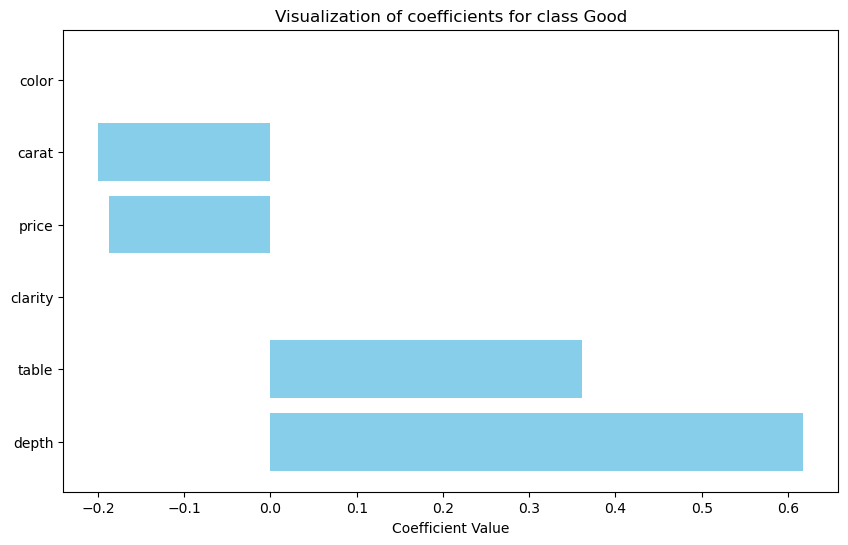

Coefficients for class Ideal:
  Feature: depth,  Coefficient: -0.8334177804943879
  Feature: table,  Coefficient: -2.301606903040857
  Feature: clarity,  Coefficient: -0.05832105635192347
  Feature: price,  Coefficient: 0.7359333015303484
  Feature: carat,  Coefficient: -0.6105046230541025
  Feature: color,  Coefficient: 0.1459704331872197
Intercept for class Ideal: -1.4467119610656394
----------------------------------
Visualization of coefficients:


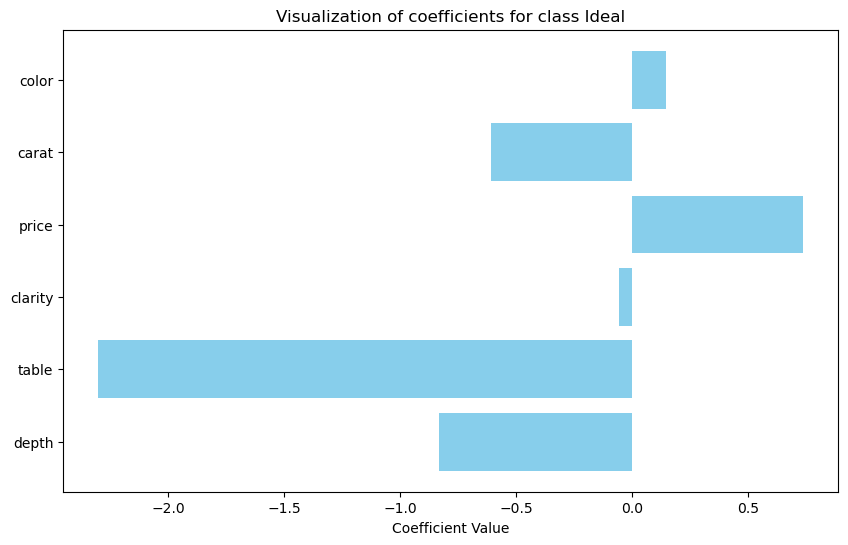

Coefficients for class Premium:
  Feature: depth,  Coefficient: -0.2715561463388358
  Feature: table,  Coefficient: 0.5492578808655646
  Feature: clarity,  Coefficient: 0.0002735826891840418
  Feature: price,  Coefficient: 0.0
  Feature: carat,  Coefficient: 0.0728968095798118
  Feature: color,  Coefficient: -0.04077628912968715
Intercept for class Premium: -0.8461102897020873
----------------------------------
Visualization of coefficients:


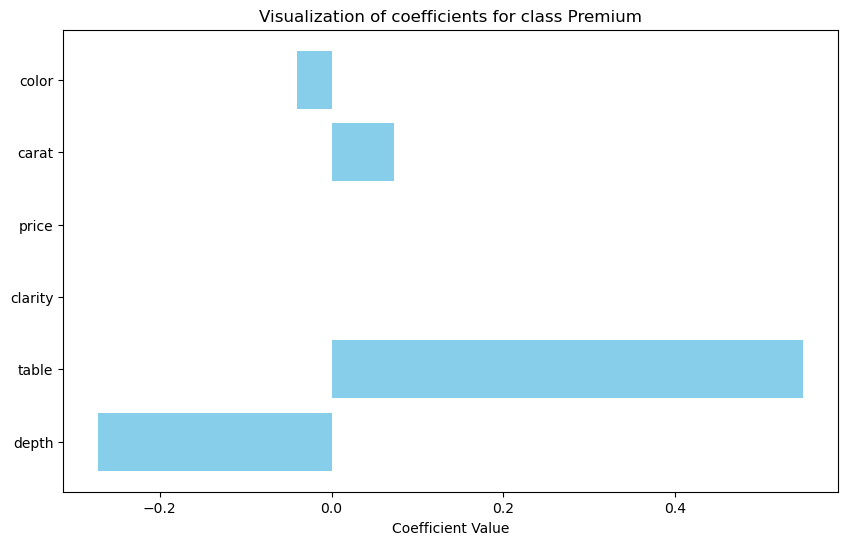

Coefficients for class Very Good:
  Feature: depth,  Coefficient: 0.13535858005519663
  Feature: table,  Coefficient: 0.2309803392166582
  Feature: clarity,  Coefficient: 0.0
  Feature: price,  Coefficient: 0.0
  Feature: carat,  Coefficient: -0.17351325541343934
  Feature: color,  Coefficient: -0.10116677542148753
Intercept for class Very Good: -1.0447380964443052
----------------------------------
Visualization of coefficients:


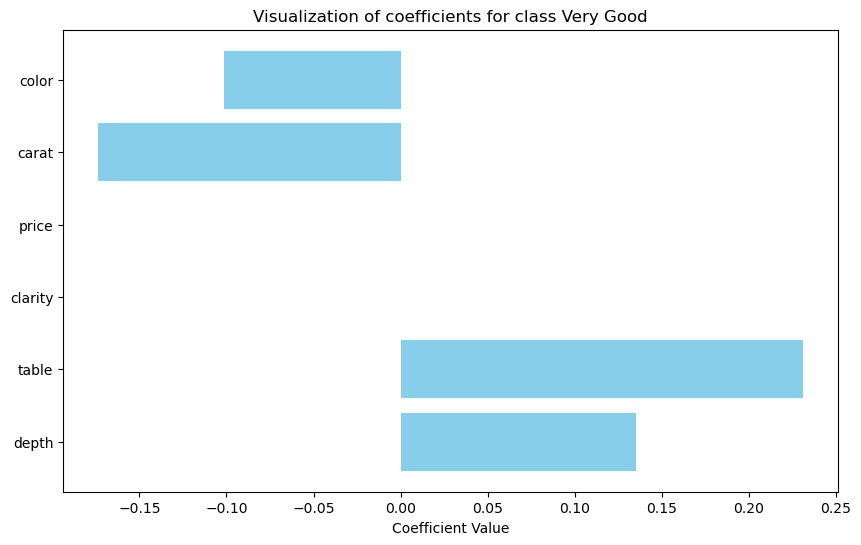

----------------------------------

Raport with scores for model RidgeRegression:
----------------------------------
Model: RidgeRegression
Parameters: {'estimator__C': 0.2998569147310718}
Score: 0.5957
Evaluation Metric:: accuracy
Training Time: 7.80 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.770116
1           accuracy  0.595714
2          precision  0.510574
3             recall  0.478775
4                 f1  0.459101
5  balanced_accuracy  0.478775
----------------------------------
Model coefficients:
Coefficients for class Fair:
  Feature: depth,  Coefficient: 0.8691711333929231
  Feature: table,  Coefficient: 1.2179018506247312
  Feature: clarity,  Coefficient: 0.06464657608389042
  Feature: price,  Coefficient: -0.42888328052981867
  Feature: carat,  Coefficient: 1.3397077569861175
  Feature: color,  Coefficient: -0.08802352390501628
Intercept for class Fair: -3.959840186700894
----------------------------------
Visualizati

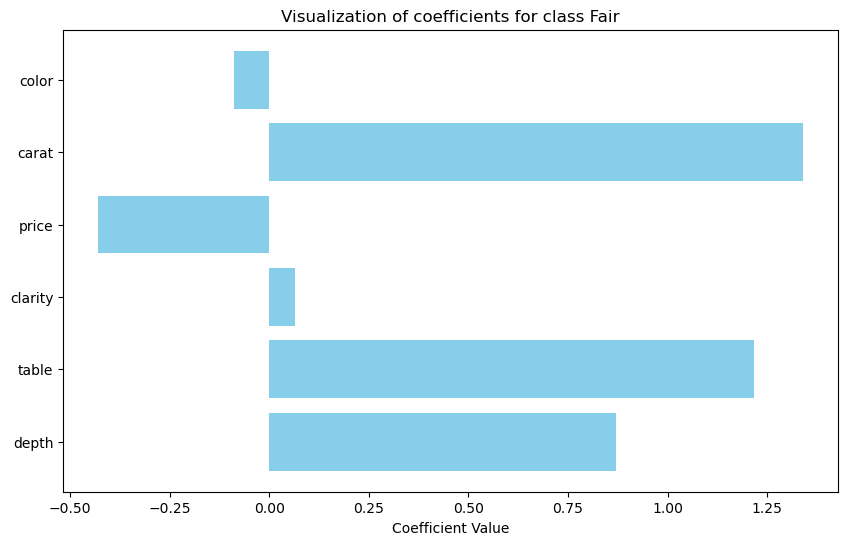

Coefficients for class Good:
  Feature: depth,  Coefficient: 0.6592874839938329
  Feature: table,  Coefficient: 0.4184545515076748
  Feature: clarity,  Coefficient: 0.019281716863119584
  Feature: price,  Coefficient: -0.17691782315691365
  Feature: carat,  Coefficient: -0.2547730722708165
  Feature: color,  Coefficient: 0.01455463820584193
Intercept for class Good: -2.660303849368676
----------------------------------
Visualization of coefficients:


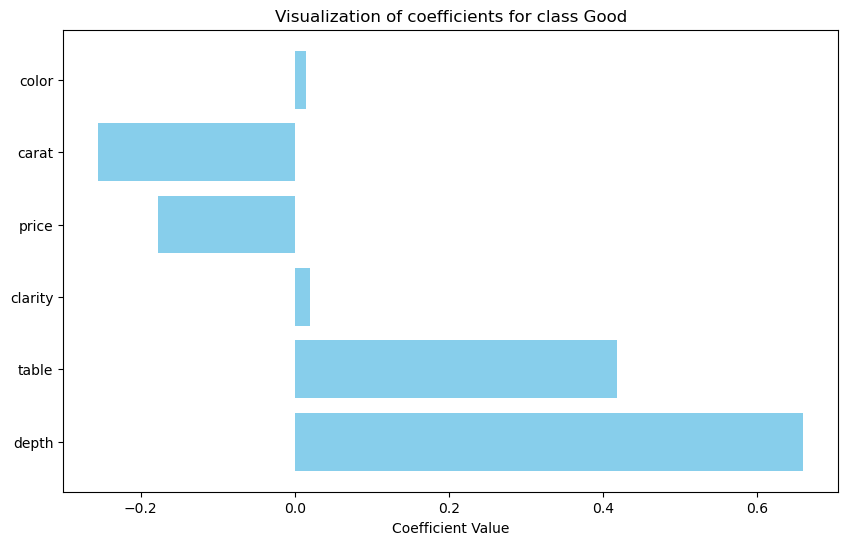

Coefficients for class Ideal:
  Feature: depth,  Coefficient: -0.7981392467053211
  Feature: table,  Coefficient: -2.170131747154846
  Feature: clarity,  Coefficient: -0.09056546203223596
  Feature: price,  Coefficient: 0.8951271646243214
  Feature: carat,  Coefficient: -0.7828137426541036
  Feature: color,  Coefficient: 0.17979225201406004
Intercept for class Ideal: -1.3689255005916707
----------------------------------
Visualization of coefficients:


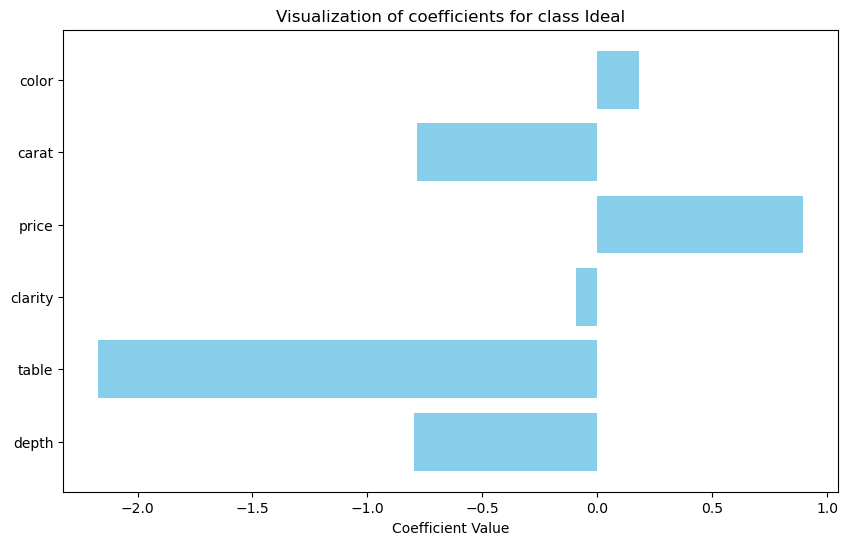

Coefficients for class Premium:
  Feature: depth,  Coefficient: -0.2929600079359705
  Feature: table,  Coefficient: 0.5463123228871598
  Feature: clarity,  Coefficient: 0.024282938682453847
  Feature: price,  Coefficient: -0.09687737653750521
  Feature: carat,  Coefficient: 0.18947386398032212
  Feature: color,  Coefficient: -0.064098367176933
Intercept for class Premium: -0.8798332682164594
----------------------------------
Visualization of coefficients:


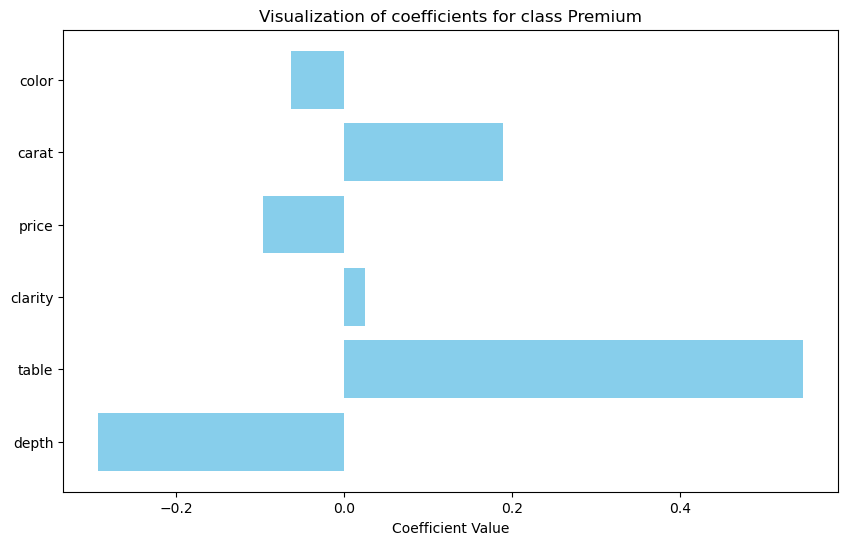

Coefficients for class Very Good:
  Feature: depth,  Coefficient: 0.18322391776349625
  Feature: table,  Coefficient: 0.27394299363056446
  Feature: clarity,  Coefficient: -0.002803222180343393
  Feature: price,  Coefficient: 0.0630448719429797
  Feature: carat,  Coefficient: -0.2604453215434281
  Feature: color,  Coefficient: -0.1046258535756534
Intercept for class Very Good: -1.0354504155620043
----------------------------------
Visualization of coefficients:


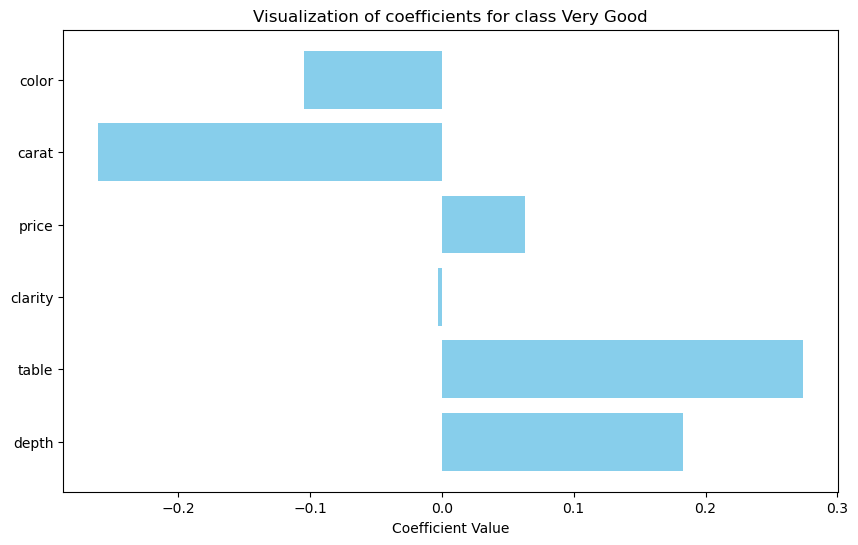

----------------------------------

Raport with scores for model LDA:
----------------------------------
Model: LDA
Parameters: {'estimator__solver': 'svd'}
Score: 0.5771
Evaluation Metric:: accuracy
Training Time: 1.32 seconds
----------------------------------
              Metric    Result
0            roc_auc  0.772224
1           accuracy  0.577143
2          precision  0.472679
3             recall  0.478999
4                 f1  0.445714
5  balanced_accuracy  0.478999
----------------------------------
Model coefficients:
Coefficients for class Fair:
  Feature: depth,  Coefficient: 1.7630318587861715
  Feature: table,  Coefficient: 1.8073100644989386
  Feature: clarity,  Coefficient: 0.2955427149810904
  Feature: price,  Coefficient: -3.0344559863596583
  Feature: carat,  Coefficient: 3.9708205878570415
  Feature: color,  Coefficient: -0.21749717279698322
Intercept for class Fair: -6.234496655932235
----------------------------------
Visualization of coefficients:


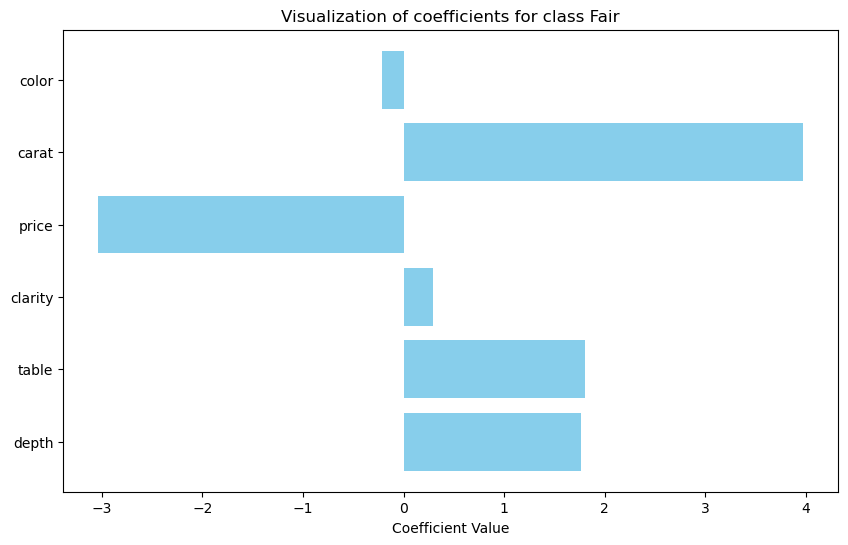

Coefficients for class Good:
  Feature: depth,  Coefficient: 0.7876012365710056
  Feature: table,  Coefficient: 0.5472002328529854
  Feature: clarity,  Coefficient: 0.022643342759001
  Feature: price,  Coefficient: -0.3823042219511006
  Feature: carat,  Coefficient: -0.1493460030577096
  Feature: color,  Coefficient: 0.001046196221865595
Intercept for class Good: -2.7383589332969622
----------------------------------
Visualization of coefficients:


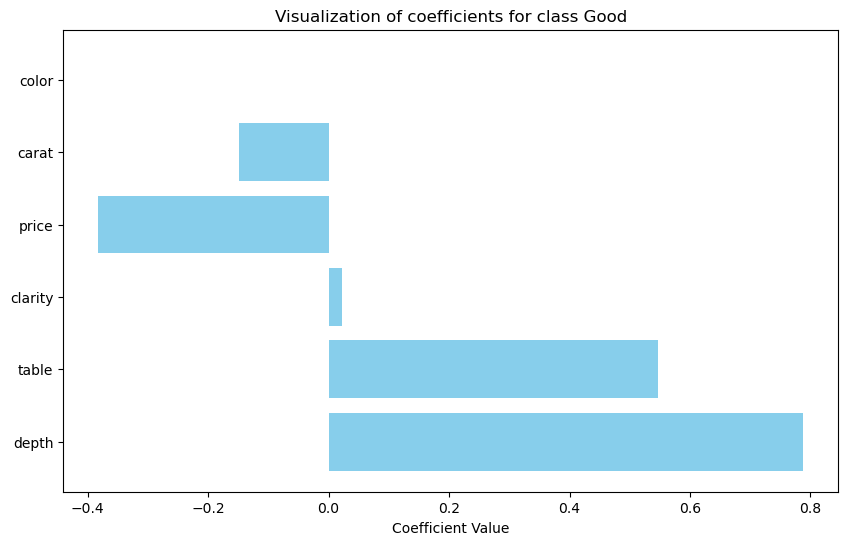

Coefficients for class Ideal:
  Feature: depth,  Coefficient: -0.7211511164402136
  Feature: table,  Coefficient: -1.8963520166867482
  Feature: clarity,  Coefficient: -0.12865168705503524
  Feature: price,  Coefficient: 1.1897067189067898
  Feature: carat,  Coefficient: -1.0387717806429526
  Feature: color,  Coefficient: 0.26343407831972065
Intercept for class Ideal: -1.260447622764349
----------------------------------
Visualization of coefficients:


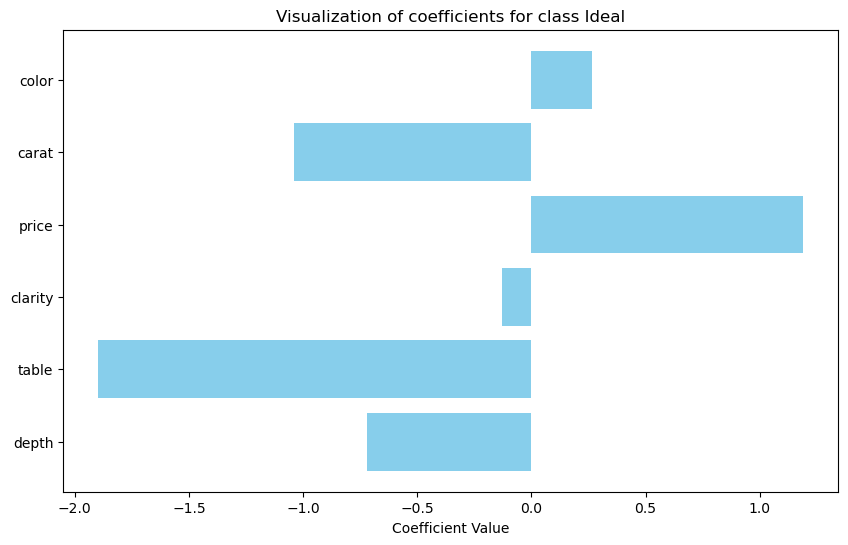

Coefficients for class Premium:
  Feature: depth,  Coefficient: -0.3295366894061624
  Feature: table,  Coefficient: 0.5767405953347505
  Feature: clarity,  Coefficient: 0.03318004170411408
  Feature: price,  Coefficient: -0.1787061667457449
  Feature: carat,  Coefficient: 0.25760507583124004
  Feature: color,  Coefficient: -0.06815049555249107
Intercept for class Premium: -0.9406941086585212
----------------------------------
Visualization of coefficients:


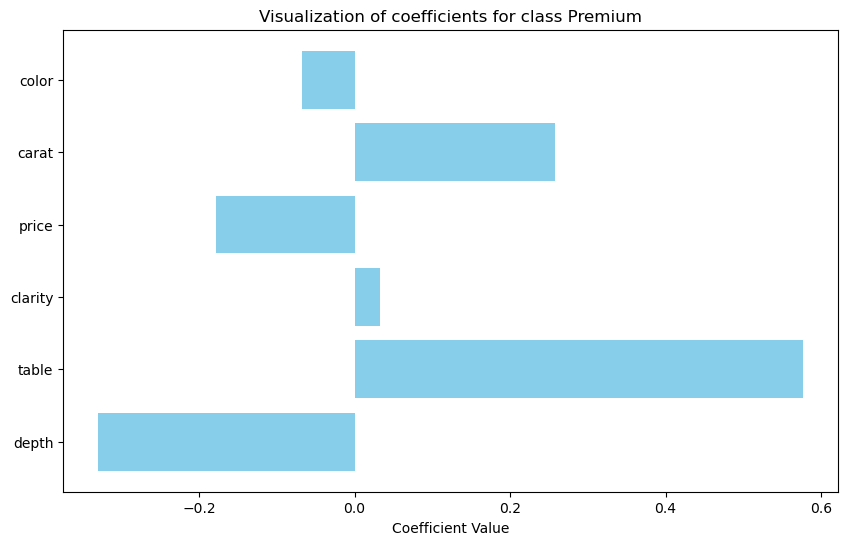

Coefficients for class Very Good:
  Feature: depth,  Coefficient: 0.19559825288474053
  Feature: table,  Coefficient: 0.3006788776824506
  Feature: clarity,  Coefficient: -0.009032213308595695
  Feature: price,  Coefficient: 0.0938820678207317
  Feature: carat,  Coefficient: -0.3015735584360143
  Feature: color,  Coefficient: -0.09797818724057354
Intercept for class Very Good: -1.0328645238401741
----------------------------------
Visualization of coefficients:


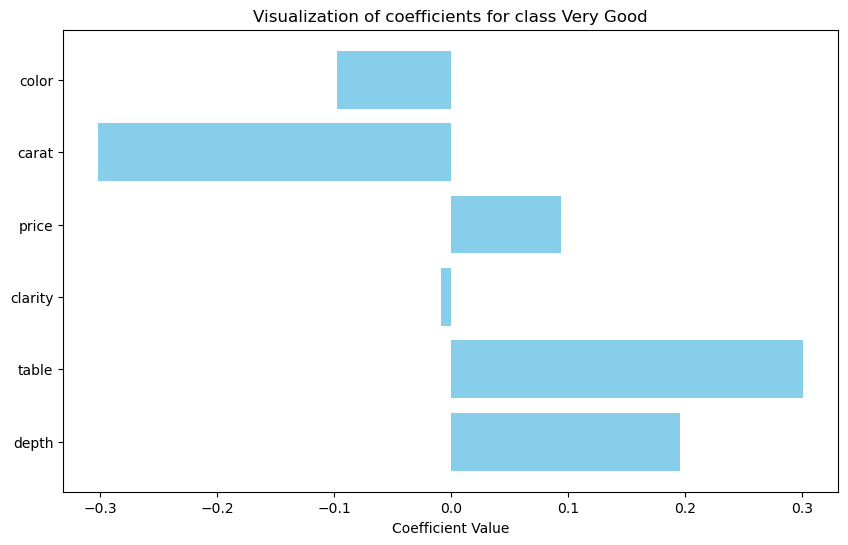

----------------------------------
Means and covariance matrix:
Class Fair:
Means: [[-0.06034835 -0.06711673  3.57990868 -0.02389762 -0.07143838  2.29984779]
 [ 0.92206666  1.02548119  2.97674419  0.36513342  1.09151201  3.1627907 ]]
Covariance matrix: [[ 0.9443548  -0.42253093 -0.07622256 -0.07947377 -0.02103768  0.26101889]
 [-0.42253093  0.93117306  0.0334447   0.06390504  0.07657855 -0.14458241]
 [-0.07622256  0.0334447   2.69575934  0.09191942 -0.26497046 -0.03154174]
 [-0.07947377  0.06390504  0.09191942  0.99127418  0.83153848 -0.42050991]
 [-0.02103768  0.07657855 -0.26497046  0.83153848  0.92202415  0.00597195]
 [ 0.26101889 -0.14458241 -0.03154174 -0.42050991  0.00597195  2.89112921]]
----------------------------------
Class Good:
Means: [[-0.05037584 -0.01726502  3.54388715  0.04223906  0.03062288  2.32445141]
 [ 0.51838366  0.17766267  3.53225806 -0.43465358 -0.31511936  2.64516129]]
Covariance matrix: [[ 0.97388599 -0.36959474 -0.1098526  -0.03554253  0.06070768  0.2951719

In [21]:
# Training models and generating report
pipeline.train(X_train, y_train)

In [22]:
# Generating a summary report for the training phase
pipeline.summary

,carat,depth,table,price,x,y,z
count,700.000000,700.000000,700.00000,700.000000,700.000000,700.000000,700.000000
mean,0.688671,61.700714,57.69700,2469.520000,5.607543,5.600186,3.456514
std,0.195029,1.760937,2.40624,845.445982,0.625193,0.612893,0.385712
min,0.200000,53.100000,52.00000,326.000000,3.790000,3.750000,2.270000
25%,0.700000,60.900000,56.00000,2774.000000,5.630000,5.630000,3.450000
50%,0.710000,61.800000,57.00000,2818.000000,5.760000,5.760000,3.550000
75%,0.780000,62.600000,59.00000,2856.000000,5.920000,5.910000,3.640000
max,1.270000,68.200000,70.00000,2898.000000,7.120000,7.050000,4.330000


#### Step 4: Simmarizing and making predictions on new data

In [23]:
# Additional outputs to inspect
print("Unique Values in Target:", pipeline.unique_values)
print("Final Selected Features:", pipeline.final_features)
print("Training Results Summary:")
print(pipeline.results)

Unique Values in Target: ['Fair', 'Good', 'Ideal', 'Premium', 'Very Good']
Final Selected Features: ['depth', 'table', 'clarity', 'price', 'carat', 'color']
Training Results Summary:
[('RandomForest', {'estimator__n_estimators': 417, 'estimator__min_samples_split': 10, 'estimator__max_depth': 4}, 0.6857142857142857, 'accuracy', 227.41193866729736), ('DecisionTree', {'estimator__min_samples_split': 9, 'estimator__max_depth': 2}, 0.68, 'accuracy', 3.2584586143493652), ('XGBoost', {'estimator__learning_rate': 0.0061751603887259315, 'estimator__max_depth': 2, 'estimator__n_estimators': 151}, 0.6871428571428572, 'accuracy', 106.73867154121399), ('GradientBoosting', {'estimator__learning_rate': 0.0061751603887259315, 'estimator__max_depth': 2, 'estimator__n_estimators': 151}, 0.6900000000000001, 'accuracy', 281.967396736145), ('LogisticRegression', {}, 0.5814285714285715, 'accuracy', 0.4767310619354248), ('LassoRegression', {'estimator__C': 0.2998569147310718}, 0.5957142857142858, 'accuracy'

In [24]:
pipeline.scores['DecisionTree']

,Metric,Result
0,roc_auc,0.843827
1,accuracy,0.680000
2,precision,0.683483
3,recall,0.642057
4,f1,0.616307
5,balanced_accuracy,0.642057


In [25]:
pipeline.optimizers['RandomForest']

OneVsRestClassifier(estimator=RandomForestClassifier(max_depth=4,
                                                     min_samples_split=10,
                                                     n_estimators=417,
                                                     random_state=2024))

In [26]:
pipeline.all_results

,Model_Name,Best_Params,Best_Score,Eval_Scoring,Training_Time
0,RandomForest,"{'estimator__n_estimators': 417, 'estimator__m...",0.6857,accuracy,227.41 seconds
1,DecisionTree,"{'estimator__min_samples_split': 9, 'estimator...",0.6800,accuracy,3.26 seconds
2,XGBoost,{'estimator__learning_rate': 0.006175160388725...,0.6871,accuracy,106.74 seconds
3,GradientBoosting,{'estimator__learning_rate': 0.006175160388725...,0.6900,accuracy,281.97 seconds
4,LogisticRegression,{},0.5814,accuracy,0.48 seconds
5,LassoRegression,{'estimator__C': 0.2998569147310718},0.5957,accuracy,4.41 seconds
6,RidgeRegression,{'estimator__C': 0.2998569147310718},0.5957,accuracy,7.80 seconds
7,LDA,{'estimator__solver': 'svd'},0.5771,accuracy,1.32 seconds
8,QDA,{'estimator__reg_param': 0.0009796872969068365},0.6029,accuracy,3.30 seconds


In [27]:
pipeline.predict(X_test, model_name = 'RandomForest')

array([3, 2, 3, 2, 2, 3, 3, 2, 4, 3, 3, 3, 2, 2, 3, 0, 3, 0, 3, 3, 3, 2,
       2, 3, 4, 3, 2, 2, 2, 3, 2, 2, 2, 1, 4, 2, 2, 2, 2, 1, 3, 3, 3, 3,
       4, 3, 3, 4, 0, 2, 3, 0, 1, 2, 3, 2, 3, 1, 3, 2, 0, 3, 3, 2, 3, 1,
       2, 3, 3, 3, 2, 2, 3, 3, 2, 3, 3, 2, 2, 2, 3, 2, 4, 4, 2, 2, 3, 0,
       3, 2, 4, 2, 3, 3, 3, 2, 4, 3, 2, 3, 2, 2, 3, 2, 0, 4, 2, 2, 2, 2,
       3, 2, 3, 3, 3, 2, 3, 2, 3, 3, 2, 2, 3, 3, 2, 3, 2, 2, 2, 2, 2, 3,
       2, 2, 3, 3, 2, 3, 3, 3, 4, 4, 2, 2, 2, 3, 2, 1, 2, 4, 3, 3, 2, 3,
       2, 3, 2, 3, 2, 0, 0, 2, 2, 2, 2, 3, 0, 2, 0, 3, 3, 3, 2, 2, 4, 2,
       3, 3, 3, 1, 2, 3, 2, 0, 2, 3, 3, 2, 2, 3, 4, 2, 3, 3, 2, 2, 2, 2,
       2, 4, 2, 2, 2, 2, 2, 3, 3, 2, 3, 2, 2, 2, 3, 3, 2, 2, 1, 2, 3, 2,
       3, 2, 4, 3, 2, 1, 4, 2, 2, 3, 2, 3, 3, 2, 3, 2, 4, 2, 3, 0, 3, 0,
       0, 3, 3, 2, 2, 2, 4, 3, 3, 2, 3, 3, 3, 3, 2, 2, 4, 4, 2, 3, 0, 3,
       2, 3, 3, 3, 2, 2, 3, 3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 3, 3, 3, 2,
       0, 2, 0, 2, 1, 2, 3, 3, 3, 2, 4, 1, 2, 2])

In [28]:
pipeline.predict_proba(X_test)

array([[0.027896  , 0.04860997, 0.1728151 , 0.51240786, 0.23827107],
       [0.02617633, 0.04561336, 0.60441494, 0.15889393, 0.16490144],
       [0.027896  , 0.04860997, 0.1728151 , 0.51240786, 0.23827107],
       ...,
       [0.03098085, 0.43292292, 0.18890354, 0.19648002, 0.15071266],
       [0.02508136, 0.04370534, 0.57913205, 0.15224734, 0.19983391],
       [0.0259076 , 0.04514509, 0.53810998, 0.17444209, 0.21639523]])

#### Step 5: Generating report on test dataset

Testing Results:

Report with scores for model GradientBoosting on the test set:
----------------------------------
Metric values on the test set:
              Metric   Score
0           accuracy  0.6567
1          precision  0.6716
2             recall  0.6032
3                 f1  0.5882
4  balanced_accuracy  0.6032
5                AUC  0.8651
----------------------------------
ROC Curve:


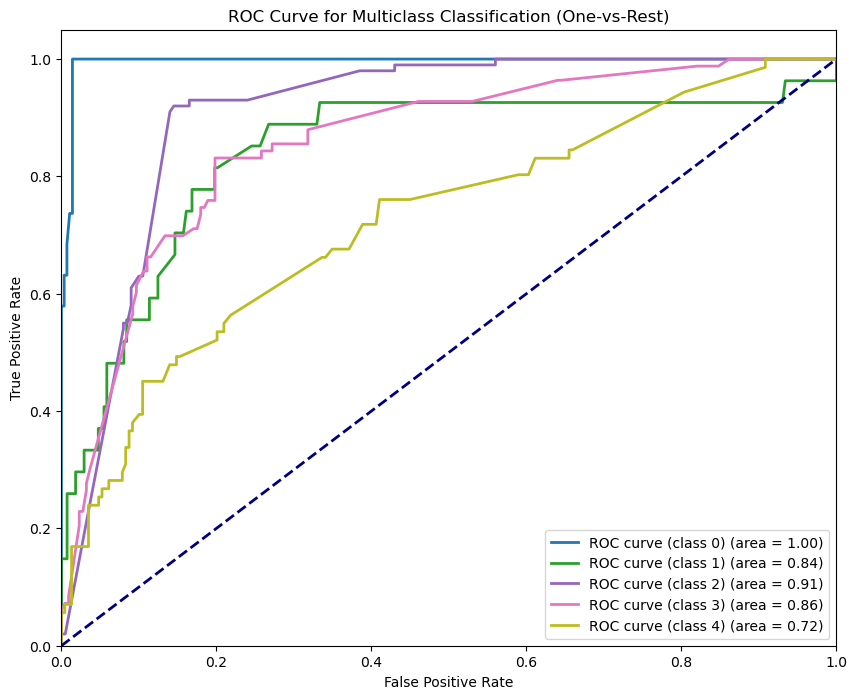

----------------------------------
Confusion Matrix:


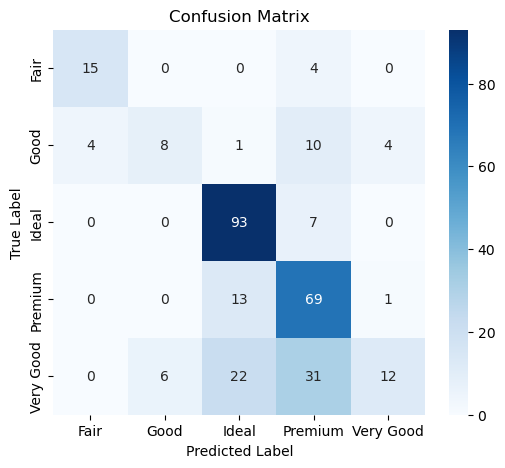

----------------------------------
Other metrics:
Mean Gini: 0.6419
Mean Entropy: 1.7846
----------------------------------


In [29]:
# Predictions and evaluation on test data
print("Testing Results:")
pipeline.predict_and_report(X_test, y_test, prediction_threshold = 0.6)

### Example of using the package for regression

#### Step 1: Loading and Exploring Data

In [30]:
from sklearn.datasets import fetch_openml
import pandas as pd

# Loading sample dataset
autoPrice = fetch_openml("autoPrice", version = 1)

y = autoPrice.target
X = autoPrice.data

In [33]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
abalone = fetch_ucirepo(id=1)

# data (as pandas dataframes)
X = abalone.data.features
y = abalone.data.targets

y = y.squeeze()

In [34]:
from sklearn.model_selection import train_test_split

# Splitting into train and test datasets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [35]:
# Displaying data sample and target distribution
print("Training Data Sample:")
print(X_train.head())
print("Training Target Distribution:")
print(y_train.value_counts())

print("Testing Data Sample:")
print(X_test.head())
print("Testing Target Distribution:")
print(y_test.value_counts())

Training Data Sample:
     Sex  Length  Diameter  Height  Whole_weight  Shucked_weight  \
2830   F   0.525     0.430   0.135        0.8435          0.4325   
925    I   0.430     0.325   0.100        0.3645          0.1575   
3845   M   0.455     0.350   0.105        0.4160          0.1625   
547    M   0.205     0.155   0.045        0.0425          0.0170   
2259   F   0.590     0.465   0.160        1.1005          0.5060   

      Viscera_weight  Shell_weight  
2830          0.1800        0.1815  
925           0.0825        0.1050  
3845          0.0970        0.1450  
547           0.0055        0.0155  
2259          0.2525        0.2950  
Training Target Distribution:
Rings
9     477
10    443
8     404
11    350
7     262
12    183
6     182
13    150
14     92
15     72
5      70
16     46
17     44
4      38
18     27
19     24
20     20
3      12
21     11
23      4
22      3
27      2
24      2
29      1
2       1
26      1
1       1
25      1
Name: count, dtype: int64
Testi

#### Step 2: Creating and Configuring AutoFinancer Object

In [36]:
from autofinancer import AutoFinancer

pipeline = AutoFinancer(problem_type = 'regression', selection_method = 'random_forest')

#### Step 3: Training Models

Training model: RandomForest
Preparation of a new explainer is initiated

  -> data              : 2923 rows 3 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 2923 values
  -> model_class       : sklearn.model_selection._search.RandomizedSearchCV (default)
  -> label             : RandomForest
  -> predict function  : <function yhat_default at 0x000001F35C2C4AE0> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 2.2, mean = 9.98, max = 16.6
  -> model type        : regression will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -6.39, mean = 0.00626, max = 16.2
  -> model_info        : package sklearn

A new explainer has been created!
Training model: DecisionTree
Preparation of a new explainer is initiated

  -> data              : 2923 rows 3 cols
  -> target variable   : Para

C:\Users\XXX\anaconda3\Lib\site-packages\sklearn\model_selection\_search.py:320: UserWarning:

The total space of parameters 1 is smaller than n_iter=10. Running 1 iterations. For exhaustive searches, use GridSearchCV.



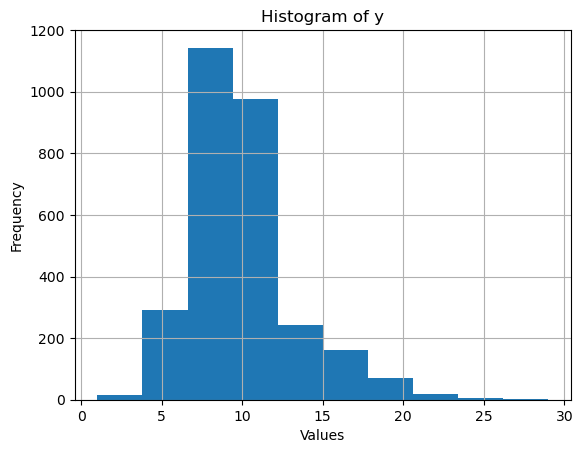

----------------------------------
Permutation feature importance:


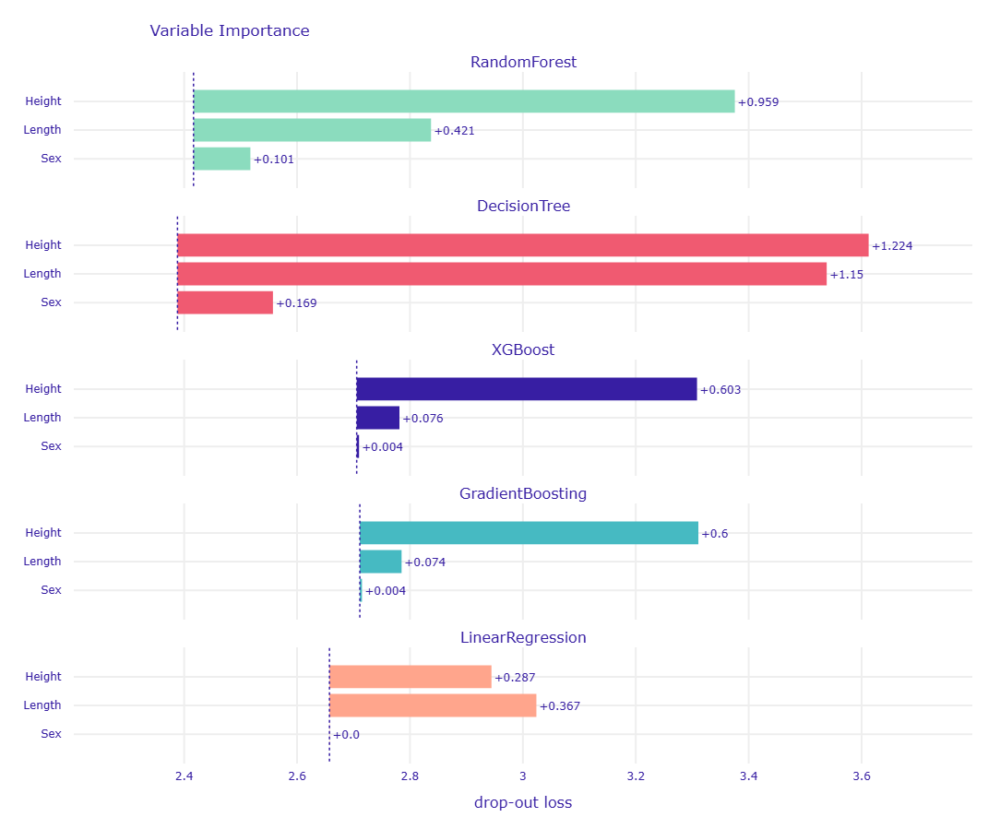

None
----------------------------------
Partial dependence profiles (PDP):


Calculating ceteris paribus: 100%|██████████| 3/3 [00:00<00:00, 115.51it/s]


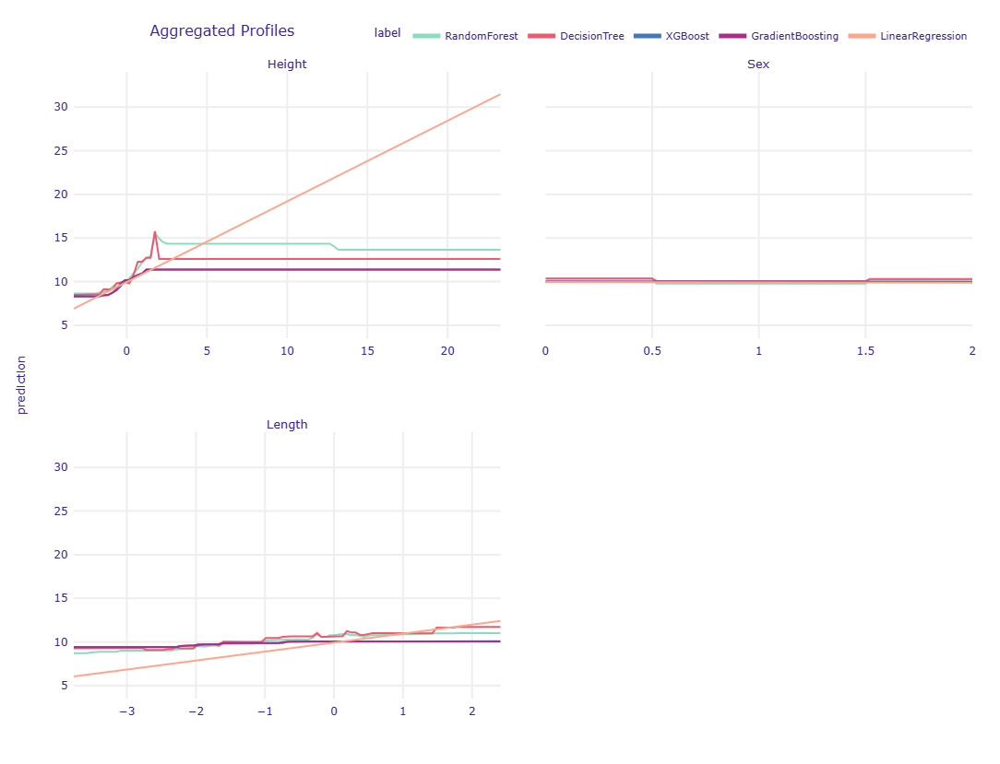

None
----------------------------------
Accumulated local dependence profiles (ALE):


Calculating accumulated dependency: 100%|██████████| 3/3 [00:00<00:00,  9.91it/s]


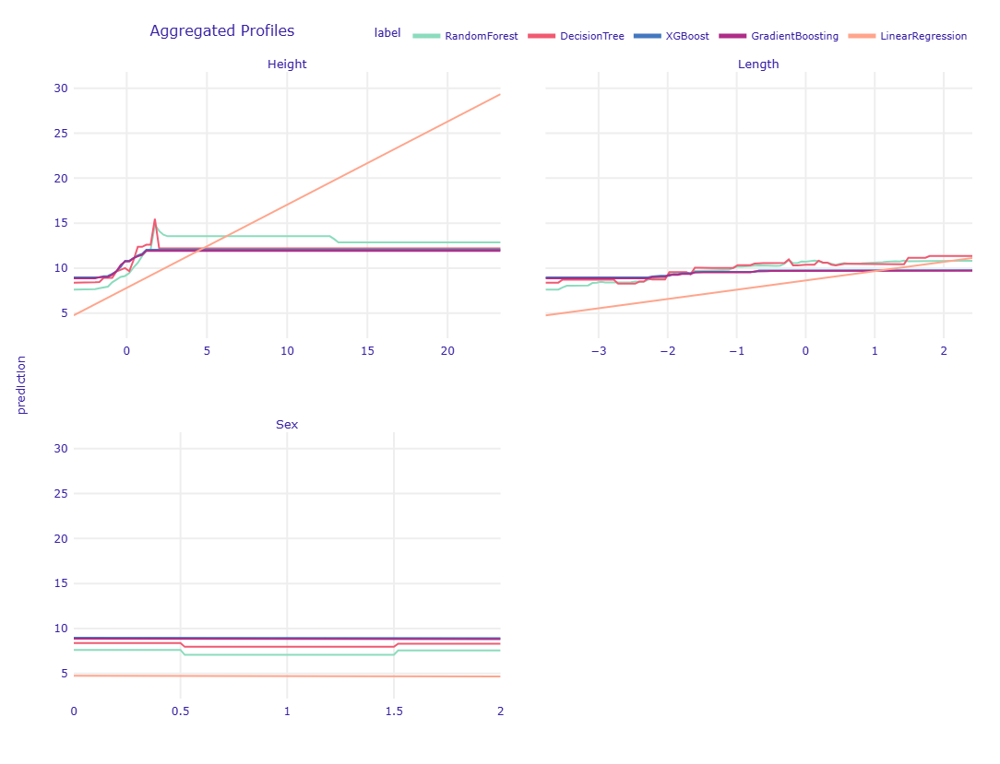

None
----------------------------------
Break Down plots for observations with the largest prediction difference from actual values for the best model:
----------------------------------
Break Down plot for observation no. 505:


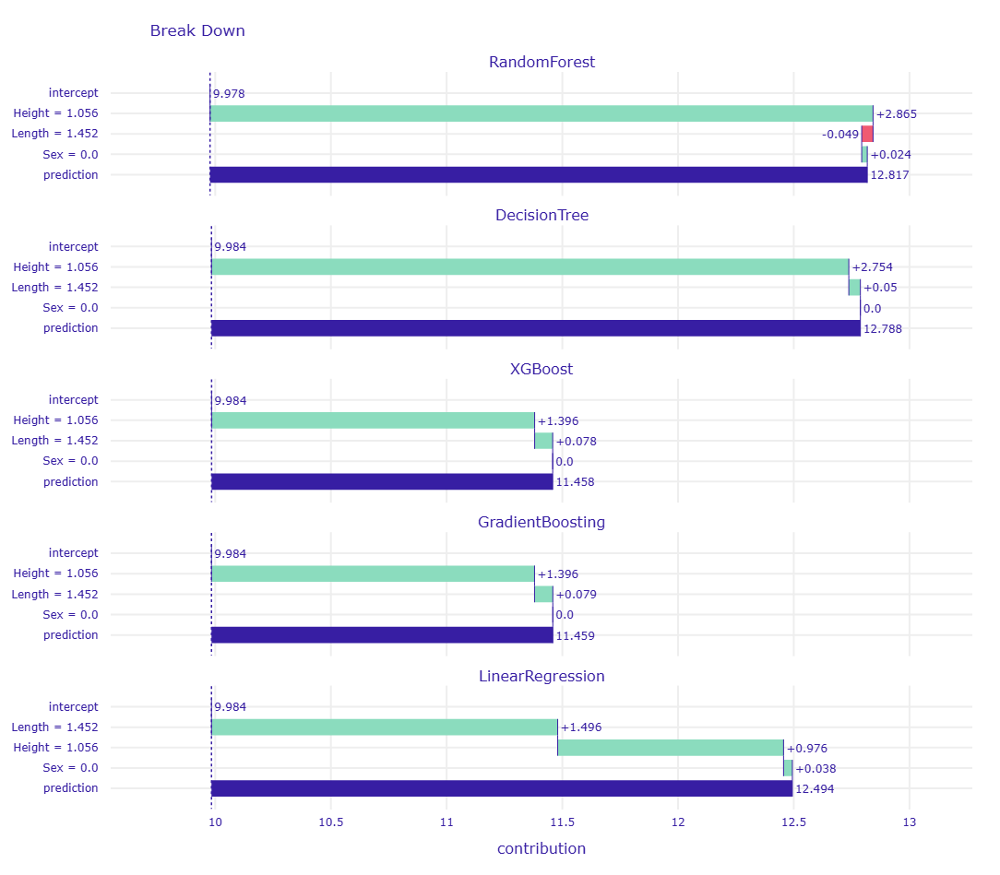

None
----------------------------------
Break Down plots for observations with the smallest prediction difference from actual values for the best model:
----------------------------------
Break Down plot for observation no. 2354:


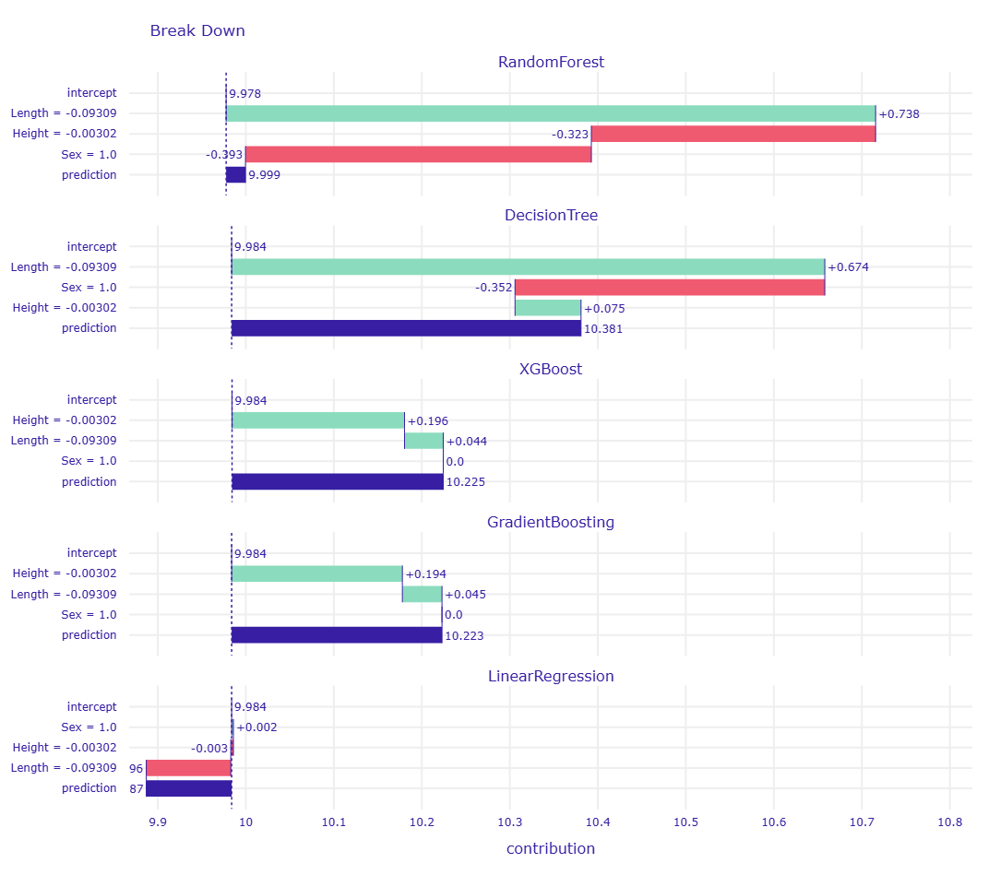

None
----------------------------------
Ceteris Paribus plots for observations with the largest prediction difference from actual values for the best model:
----------------------------------
Ceteris Paribus plot for observation no. 505:


Calculating ceteris paribus: 100%|██████████| 3/3 [00:00<00:00, 75.20it/s]


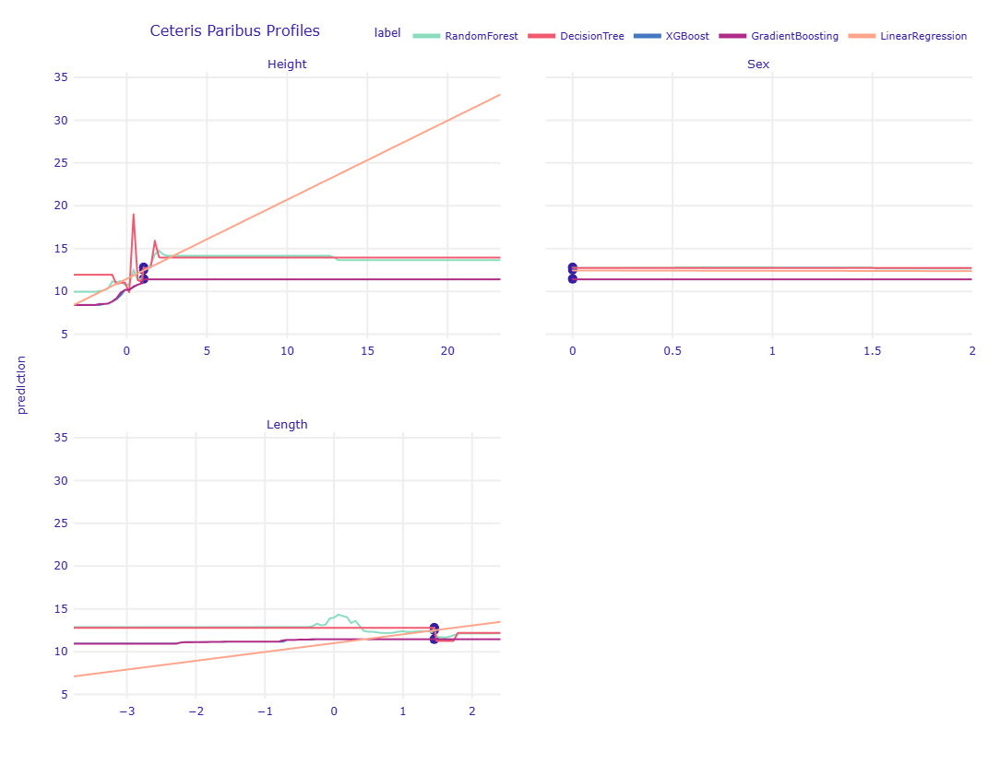

None
----------------------------------
Ceteris Paribus plots for observations with the smallest prediction difference from actual values for the best model:
----------------------------------
Ceteris Paribus plot for observation no. 2354:


Calculating ceteris paribus: 100%|██████████| 3/3 [00:00<00:00, 158.32it/s]


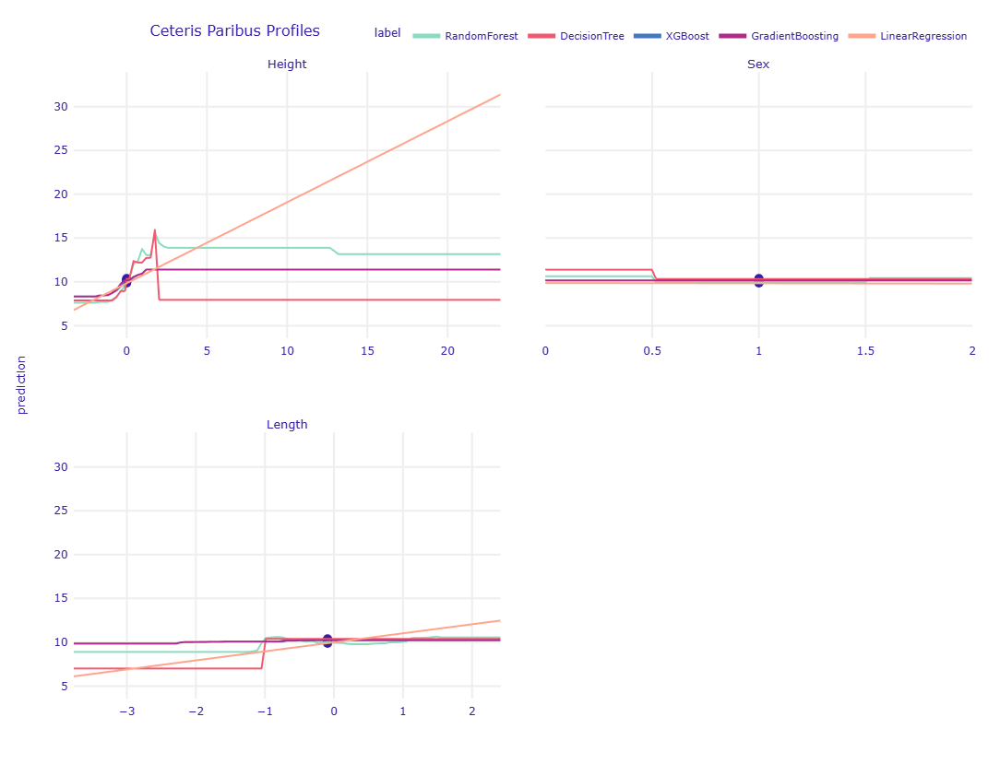

None
----------------------------------

Raport with scores for model RandomForest:
----------------------------------
Model: RandomForest
Parameters: {'n_estimators': 352, 'min_samples_split': 10, 'max_depth': 6}
Score: 0.3935
Evaluation Metric: r2
Training Time: 53.44 seconds
----------------------------------
                    Metric    Result
0                       r2  0.393454
1   neg_mean_squared_error -6.339702
2  neg_mean_absolute_error -1.787702
----------------------------------
Visualization of the first decision tree:


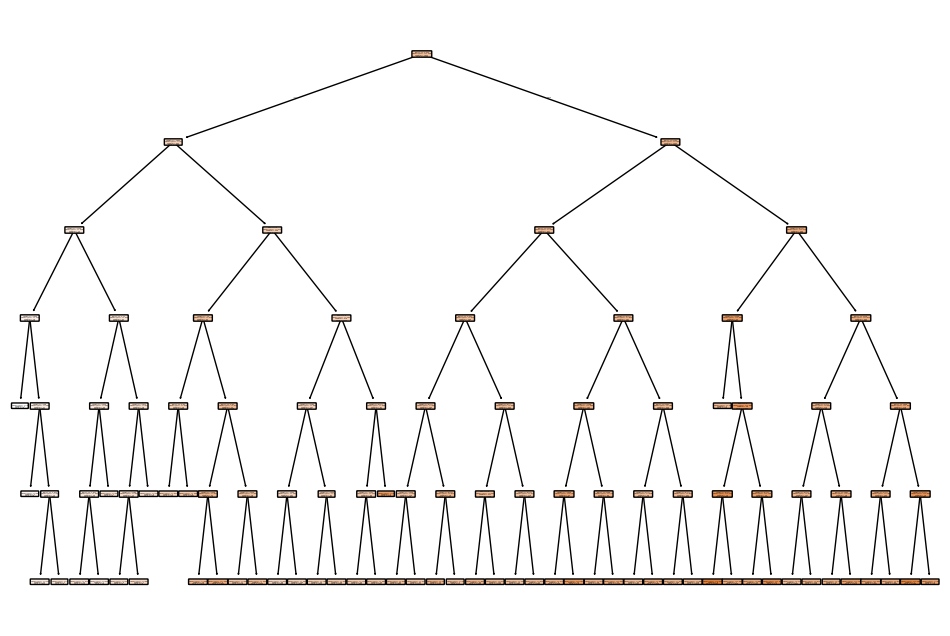

----------------------------------
Feature Importance:


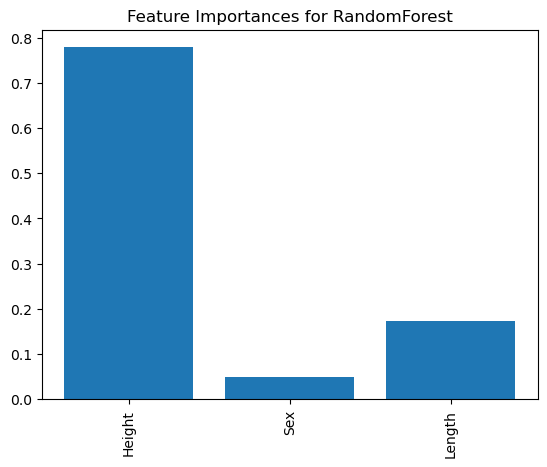

----------------------------------

Raport with scores for model DecisionTree:
----------------------------------
Model: DecisionTree
Parameters: {'min_samples_split': 7, 'max_depth': 6}
Score: 0.3663
Evaluation Metric: r2
Training Time: 0.49 seconds
----------------------------------
                    Metric    Result
0                       r2  0.366336
1   neg_mean_squared_error -6.631012
2  neg_mean_absolute_error -1.822999
----------------------------------
Textual representation of the tree:
|--- Height <= -0.41
|   |--- Length <= -1.66
|   |   |--- Length <= -2.24
|   |   |   |--- Length <= -2.75
|   |   |   |   |--- Height <= -2.06
|   |   |   |   |   |--- Length <= -3.54
|   |   |   |   |   |   |--- value: [1.00]
|   |   |   |   |   |--- Length >  -3.54
|   |   |   |   |   |   |--- value: [3.67]
|   |   |   |   |--- Height >  -2.06
|   |   |   |   |   |--- value: [5.33]
|   |   |   |--- Length >  -2.75
|   |   |   |   |--- Sex <= 1.50
|   |   |   |   |   |--- Length <= -2.45

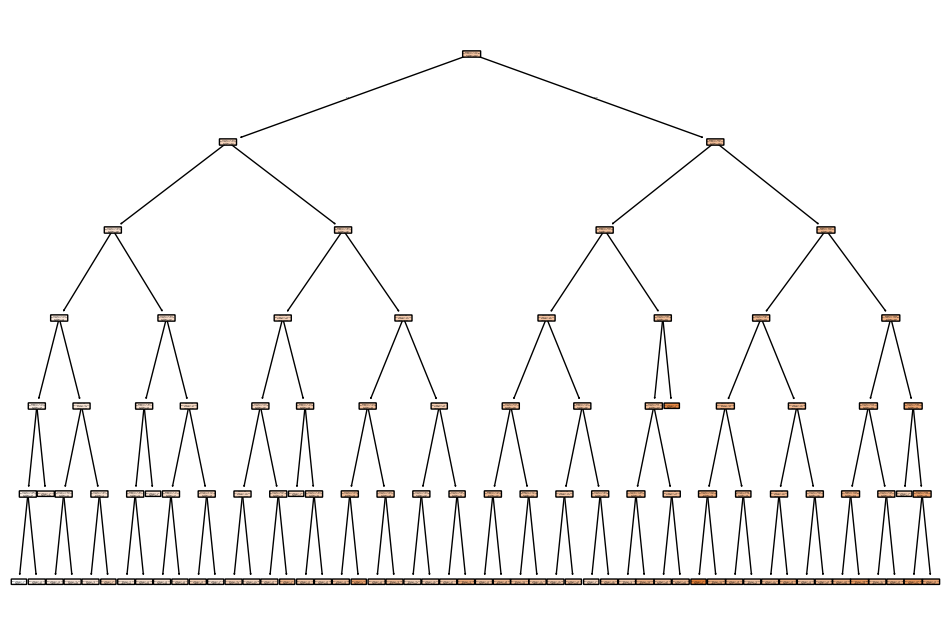

----------------------------------
Feature Importance:


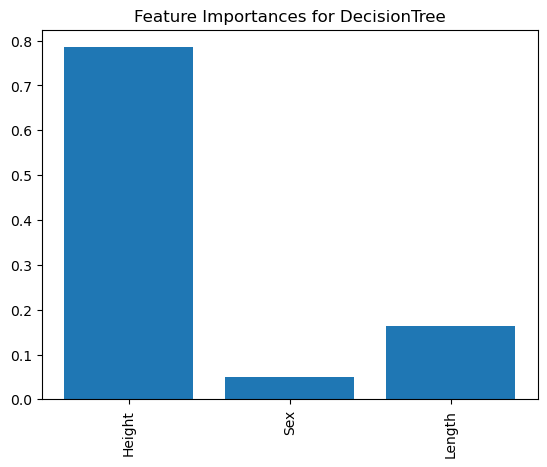

----------------------------------

Raport with scores for model XGBoost:
----------------------------------
Model: XGBoost
Parameters: {'learning_rate': 0.0061751603887259315, 'max_depth': 2, 'n_estimators': 151}
Score: 0.2941
Evaluation Metric: r2
Training Time: 43.85 seconds
----------------------------------
                    Metric    Result
0                       r2  0.294089
1   neg_mean_squared_error -7.393602
2  neg_mean_absolute_error -1.974378
----------------------------------
Feature Importance:


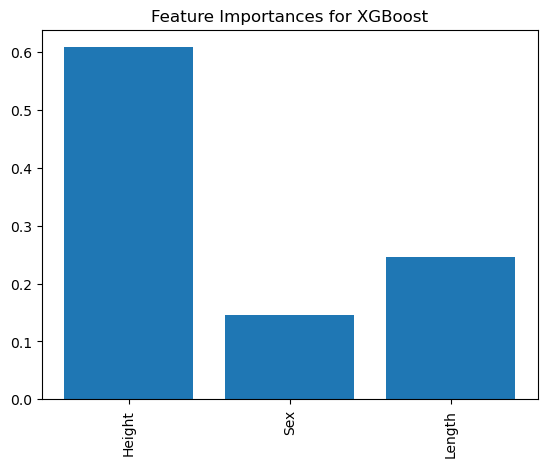

----------------------------------

Raport with scores for model GradientBoosting:
----------------------------------
Model: GradientBoosting
Parameters: {'learning_rate': 0.0061751603887259315, 'max_depth': 2, 'n_estimators': 151}
Score: 0.2945
Evaluation Metric: r2
Training Time: 36.72 seconds
----------------------------------
                    Metric    Result
0                       r2  0.294473
1   neg_mean_squared_error -7.389383
2  neg_mean_absolute_error -1.973707
----------------------------------
Visualization of the first decision tree:


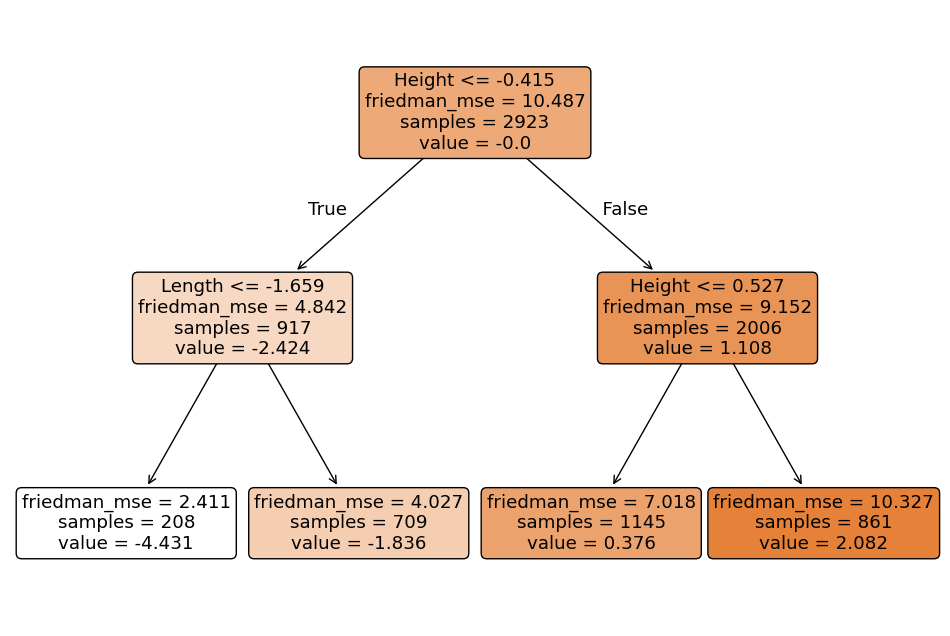

----------------------------------
Feature Importance:


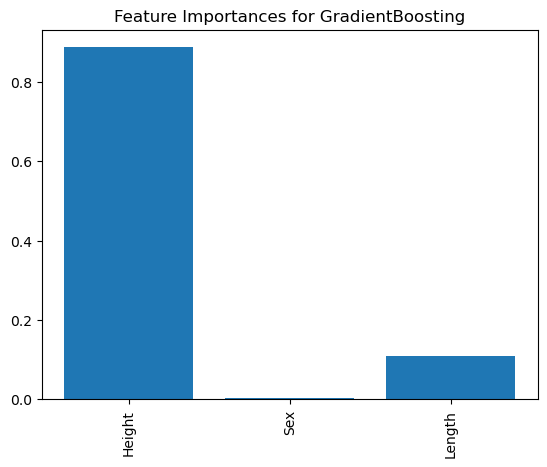

----------------------------------

Raport with scores for model LinearRegression:
----------------------------------
Model: LinearRegression
Parameters: {}
Score: 0.2653
Evaluation Metric: r2
Training Time: 0.06 seconds
----------------------------------
                    Metric    Result
0                       r2  0.265277
1   neg_mean_squared_error -7.726477
2  neg_mean_absolute_error -1.914959
----------------------------------
Model coefficients:
        Coefficient
Height     0.924174
Sex       -0.035941
Length     1.030040
Intercept: 10.021582727977716
----------------------------------
Visualization of coefficients:


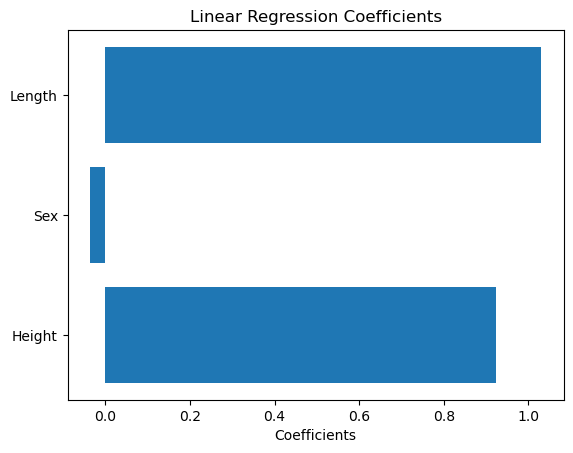

----------------------------------


In [37]:
# Training models and generating report
pipeline.train(X_train, y_train)

In [38]:
# Generating a summary report for the training phase
pipeline.summary

,Length,Diameter,Height,Whole_weight,Shucked_weight,Viscera_weight,Shell_weight
count,2923.000000,2923.000000,2923.000000,2923.000000,2923.000000,2923.000000,2923.000000
mean,0.526143,0.409531,0.140128,0.836328,0.362982,0.182291,0.241286
std,0.119723,0.098994,0.042487,0.492079,0.223530,0.109229,0.140562
min,0.075000,0.055000,0.000000,0.002000,0.001000,0.000500,0.001500
25%,0.450000,0.350000,0.115000,0.443750,0.187000,0.094500,0.130000
50%,0.545000,0.425000,0.145000,0.808500,0.340000,0.173000,0.235000
75%,0.615000,0.485000,0.165000,1.160250,0.508250,0.256000,0.330000
max,0.815000,0.650000,1.130000,2.825500,1.488000,0.760000,1.005000


#### Step 4: Summarizing and making predictions on new data

In [39]:
# Additional outputs to inspect
print("Final Selected Features:", pipeline.final_features)
print("Training Results Summary:")
print(pipeline.results)

Final Selected Features: ['Height', 'Sex', 'Length']
Training Results Summary:
[('RandomForest', {'n_estimators': 352, 'min_samples_split': 10, 'max_depth': 6}, 0.3934537669742707, 'r2', 53.43921136856079), ('DecisionTree', {'min_samples_split': 7, 'max_depth': 6}, 0.36633647456786855, 'r2', 0.48969078063964844), ('XGBoost', {'learning_rate': 0.0061751603887259315, 'max_depth': 2, 'n_estimators': 151}, 0.294089458020222, 'r2', 43.85277581214905), ('GradientBoosting', {'learning_rate': 0.0061751603887259315, 'max_depth': 2, 'n_estimators': 151}, 0.2944725778916176, 'r2', 36.71782851219177), ('LinearRegression', {}, 0.2652771338538841, 'r2', 0.06183505058288574)]


In [40]:
pipeline.scores['RandomForest']

,Metric,Result
0,r2,0.393454
1,neg_mean_squared_error,-6.339702
2,neg_mean_absolute_error,-1.787702


In [41]:
pipeline.optimizers['RandomForest']

RandomForestRegressor(max_depth=6, min_samples_split=10, n_estimators=352,
                      random_state=2024)

In [42]:
pipeline.all_results

,Model_Name,Best_Params,Best_Score,Eval_Scoring,Training_Time
0,RandomForest,"{'n_estimators': 352, 'min_samples_split': 10,...",0.3935,r2,53.44 seconds
1,DecisionTree,"{'min_samples_split': 7, 'max_depth': 6}",0.3663,r2,0.49 seconds
2,XGBoost,"{'learning_rate': 0.0061751603887259315, 'max_...",0.2941,r2,43.85 seconds
3,GradientBoosting,"{'learning_rate': 0.0061751603887259315, 'max_...",0.2945,r2,36.72 seconds
4,LinearRegression,{},0.2653,r2,0.06 seconds


In [43]:
pipeline.predict(X_test, model_name = 'XGBoost')

array([10.615757, 10.224638, 11.458433, ...,  9.24175 , 11.458433,
        8.3483  ], dtype=float32)

#### Step 5: Generating report on test dataset

In [44]:
# Predictions and evaluation on test data
print("Testing Results:")
pipeline.predict_and_report(X_test, y_test, prediction_threshold = 0.6)

Testing Results:

Report with scores for model RandomForest on the test set:
----------------------------------
Metric values on the test set:
  Metric   Score
0     r2  0.3199
1    mse  6.9061
2    mae  1.9887
----------------------------------


## Conclusion

This tutorial covered the basic usage of the `AutoFinancer` package, including data preprocessing,
model training, prediction, and report generation. By following these steps, you can easily apply automated machine learning
to various datasets and quickly obtain optimal models and insights.